# Imports

In [ ]:
!pip install pandas
!pip install numpy
!pip install matplotlib
!pip install plotly
!pip install seaborn
!pip install sklearn
!pip install scipy
!pip install openpyxl
!pip install statsmodels
!pip install zipfile

In [ ]:
!pip install factor_analyzer

In [ ]:
!pip install pingouin

In [4]:
# Procesamiento y limpieza de datos
import datetime as dt

import pandas as pd
import numpy as np
from collections import Counter

import itertools
import random

from sklearn.impute import KNNImputer

from sklearn.preprocessing import MinMaxScaler, StandardScaler

# Graficos
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

# Analisis de datos
from scipy import stats
import statsmodels.api as sm

from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

from statsmodels.tsa.stattools import adfuller

# Reducción de dimensionalidad
from sklearn.decomposition import PCA, FactorAnalysis

# Test Estadisticos
from scipy.stats import shapiro
from factor_analyzer import calculate_bartlett_sphericity, calculate_kmo, FactorAnalyzer
from pingouin import multivariate_normality

# Leer datos de kaggle
import zipfile

import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', 50)

# Contexto Base de Datos


## Conjunto de Datos: Hourly Energy Demand Generation and Weather

Este conjunto de datos fue extraído de Kaggle [1] y se llama **“Hourly energy demand generation and weather”**. Contiene dos archivos en formato `.csv` con información horaria sobre la generación eléctrica y variables meteorológicas en España para el periodo 2015-2019 (4 años).

---
### **1. Energy_dataset.csv**
Este archivo contiene información horaria sobre la generación de energía en España, desglosada por fuente de energía, así como la demanda total del sistema eléctrico nacional y el precio de la energía.

#### **Variables del dataset:**
- `time`: Fecha y hora de las mediciones.
- `generation biomass`: Generación de energía en MWh mediante biomasa.
- `generation fossil brown coal/lignite`: Generación de energía en MWh mediante carbón marrón o lignito.
- `generation fossil coal-derived gas`: Generación de energía en MWh mediante gas derivado del carbón.
- `generation fossil gas`: Generación de energía en MWh mediante gas.
- `generation fossil hard coal`: Generación de energía en MWh mediante carbón duro o hulla.
- `generation fossil oil`: Generación de energía en MWh mediante petróleo.
- `generation fossil oil shale`: Generación de energía en MWh mediante esquisto bituminoso.
- `generation fossil peat`: Generación de energía en MWh mediante turba.
- `generation geothermal`: Generación de energía en MWh mediante energía geotérmica.
- `generation hydro pumped storage aggregated`: Generación de energía en MWh mediante centrales hidroeléctricas de acumulación por bombeo agregada.
- `generation hydro pumped storage consumption`: Consumo de energía en MWh mediante centrales hidroeléctricas de acumulación por bombeo.
- `generation hydro run-of-river and poundage`: Generación de energía en MWh mediante centrales hidroeléctricas de pasada de agua y bombeo.
- `generation hydro water reservoir`: Generación de energía en MWh mediante centrales hidroeléctricas de embalse.
- `generation marine`: Generación de energía en MWh mediante energía mareomotriz.
- `generation nuclear`: Generación de energía en MWh mediante energía nuclear.
- `generation other`: Generación de energía en MWh mediante otras fuentes.
- `generation other renewable`: Generación de energía en MWh mediante otras fuentes renovables.
- `generation solar`: Generación de energía en MWh mediante paneles solares.
- `generation waste`: Generación de energía en MWh mediante residuos.
- `generation wind offshore`: Generación de energía en MWh mediante turbinas eólicas marinas.
- `generation wind onshore`: Generación de energía en MWh mediante turbinas eólicas terrestres.
- `forecast solar day ahead`: Pronóstico de generación solar al día siguiente en MWh.
- `forecast wind offshore day ahead`: Pronóstico de generación eólica marina al día siguiente en MWh.
- `forecast wind onshore day ahead`: Pronóstico de generación eólica terrestre al día siguiente en MWh.
- `total load forecast`: Pronóstico de la demanda de energía en MWh.
- `total load actual`: Demanda de energía real en MWh.
- `price day ahead`: Precio de la energía al día siguiente en €/MWh.
- `price actual`: Precio de la energía actual en €/MWh.

---
### **2. Weather_features.csv**
Este archivo contiene información horaria sobre variables meteorológicas de cinco grandes ciudades de España: **Madrid, Barcelona, Valencia, Sevilla y Bilbao**.

#### **Variables del dataset:**
- `dt_iso`: Fecha y hora de las mediciones.
- `city_name`: Nombre de la ciudad.
- `temp`: Temperatura promedio en Kelvin (K).
- `temp_min`: Temperatura mínima en Kelvin (K).
- `temp_max`: Temperatura máxima en Kelvin (K).
- `pressure`: Presión en hectopascales (hPa).
- `humidity`: Humedad en porcentaje (%).
- `wind_speed`: Velocidad del viento en metros por segundo (m/s).
- `wind_deg`: Dirección del viento en grados (°).
- `rain_1h`: Cantidad de lluvia en la última hora en milímetros (mm).
- `rain_3h`: Cantidad de lluvia en las últimas tres horas en milímetros (mm).
- `snow_3h`: Cantidad de nieve en las últimas tres horas en milímetros (mm).
- `clouds_all`: Cobertura de nubes en porcentaje (%).
- `weather_id`: Código utilizado para describir el clima.
- `weather_main`: Breve descripción del clima actual.
- `weather_description`: Descripción detallada del clima actual.
- `weather_icon`: Código de icono del clima para uso en sitios web.


Esta combinación de datasets permite realizar análisis detallados sobre cómo factores externos como el clima afectan el consumo y la generación de energía. Por ejemplo, como en este caso analizar la estructura de dependencia de la demanda de energía con las diferentes fuentes de generacion, las variables meteorológicas y los precios de la energía

# Limpieza

In [5]:
# Descargar los datos desde Kaggle
!kaggle datasets download -d nicholasjhana/energy-consumption-generation-prices-and-weather

Dataset URL: https://www.kaggle.com/datasets/nicholasjhana/energy-consumption-generation-prices-and-weather
License(s): CC0-1.0
  0% 0.00/3.81M [00:00<?, ?B/s]
100% 3.81M/3.81M [00:00<00:00, 214MB/s]


In [6]:
# Abrir el archivo .zip
zip_file_path = 'energy-consumption-generation-prices-and-weather.zip'

with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
  zip_ref.extractall()

## Energía

In [7]:
# Cargar los datos del archivo csv
file_path = 'energy_dataset.csv'
data = pd.read_csv(file_path)

In [8]:
# Mostrar tabla
data.head()

,time,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,generation hydro pumped storage aggregated,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation marine,generation nuclear,generation other,generation other renewable,generation solar,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
0,2015-01-01 00:00:00+01:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,NaN,863.0,1051.0,1899.0,0.0,7096.0,43.0,73.0,49.0,196.0,0.0,6378.0,17.0,NaN,6436.0,26118.0,25385.0,50.10,65.41
1,2015-01-01 01:00:00+01:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,NaN,920.0,1009.0,1658.0,0.0,7096.0,43.0,71.0,50.0,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2,2015-01-01 02:00:00+01:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,NaN,1164.0,973.0,1371.0,0.0,7099.0,43.0,73.0,50.0,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48
3,2015-01-01 03:00:00+01:00,438.0,254.0,0.0,4314.0,4131.0,160.0,0.0,0.0,0.0,NaN,1503.0,949.0,779.0,0.0,7098.0,43.0,75.0,50.0,191.0,0.0,5238.0,2.0,NaN,5151.0,22642.0,21286.0,42.27,59.32
4,2015-01-01 04:00:00+01:00,428.0,187.0,0.0,4130.0,3840.0,156.0,0.0,0.0,0.0,NaN,1826.0,953.0,720.0,0.0,7097.0,43.0,74.0,42.0,189.0,0.0,4935.0,9.0,NaN,4861.0,21785.0,20264.0,38.41,56.04


In [9]:
# Tamaño de la base de datos
data.shape

(35064, 29)

In [10]:
data.columns

Index(['time', 'generation biomass', 'generation fossil brown coal/lignite',
       'generation fossil coal-derived gas', 'generation fossil gas',
       'generation fossil hard coal', 'generation fossil oil',
       'generation fossil oil shale', 'generation fossil peat',
       'generation geothermal', 'generation hydro pumped storage aggregated',
       'generation hydro pumped storage consumption',
       'generation hydro run-of-river and poundage',
       'generation hydro water reservoir', 'generation marine',
       'generation nuclear', 'generation other', 'generation other renewable',
       'generation solar', 'generation waste', 'generation wind offshore',
       'generation wind onshore', 'forecast solar day ahead',
       'forecast wind offshore eday ahead', 'forecast wind onshore day ahead',
       'total load forecast', 'total load actual', 'price day ahead',
       'price actual'],
      dtype='object')

In [11]:
# Convertir la columna de tiempo a formato de fecha
data['time'] = pd.to_datetime(data['time'])

# Filtrar a conveniencia los ultimos meses para no tener muchos datos en los graficos
last_date = data['time'].max()

# Con valores grandes no hace nada el filtro
last_months = last_date - pd.DateOffset(months=100)

filtered_data = data[data['time'] >= last_months].reset_index(drop=True)

In [12]:
filtered_data.head()

,time,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,generation hydro pumped storage aggregated,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation marine,generation nuclear,generation other,generation other renewable,generation solar,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
0,2015-01-01 00:00:00+01:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,NaN,863.0,1051.0,1899.0,0.0,7096.0,43.0,73.0,49.0,196.0,0.0,6378.0,17.0,NaN,6436.0,26118.0,25385.0,50.10,65.41
1,2015-01-01 01:00:00+01:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,NaN,920.0,1009.0,1658.0,0.0,7096.0,43.0,71.0,50.0,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2,2015-01-01 02:00:00+01:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,NaN,1164.0,973.0,1371.0,0.0,7099.0,43.0,73.0,50.0,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48
3,2015-01-01 03:00:00+01:00,438.0,254.0,0.0,4314.0,4131.0,160.0,0.0,0.0,0.0,NaN,1503.0,949.0,779.0,0.0,7098.0,43.0,75.0,50.0,191.0,0.0,5238.0,2.0,NaN,5151.0,22642.0,21286.0,42.27,59.32
4,2015-01-01 04:00:00+01:00,428.0,187.0,0.0,4130.0,3840.0,156.0,0.0,0.0,0.0,NaN,1826.0,953.0,720.0,0.0,7097.0,43.0,74.0,42.0,189.0,0.0,4935.0,9.0,NaN,4861.0,21785.0,20264.0,38.41,56.04


In [13]:
filtered_data.shape

(35064, 29)

## Clima

In [14]:
# Cargar los datos del archivo csv
file_path = 'weather_features.csv'
data_clima = pd.read_csv(file_path)

In [15]:
# Mostrar tabla
data_clima.head()

,dt_iso,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,2015-01-01 00:00:00+01:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
1,2015-01-01 01:00:00+01:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
2,2015-01-01 02:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
3,2015-01-01 03:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
4,2015-01-01 04:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n


In [16]:
data_clima

,dt_iso,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,2015-01-01 00:00:00+01:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
1,2015-01-01 01:00:00+01:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
2,2015-01-01 02:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
3,2015-01-01 03:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
4,2015-01-01 04:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178391,2018-12-31 19:00:00+01:00,Seville,287.760,287.150,288.150,1028,54,3,30,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178392,2018-12-31 20:00:00+01:00,Seville,285.760,285.150,286.150,1029,62,3,30,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178393,2018-12-31 21:00:00+01:00,Seville,285.150,285.150,285.150,1028,58,4,50,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178394,2018-12-31 22:00:00+01:00,Seville,284.150,284.150,284.150,1029,57,4,60,0.0,0.0,0.0,0,800,clear,sky is clear,01n


In [17]:
# Tamaño de la base de datos
data_clima.shape

(178396, 17)

In [18]:
data_clima.columns

Index(['dt_iso', 'city_name', 'temp', 'temp_min', 'temp_max', 'pressure',
       'humidity', 'wind_speed', 'wind_deg', 'rain_1h', 'rain_3h', 'snow_3h',
       'clouds_all', 'weather_id', 'weather_main', 'weather_description',
       'weather_icon'],
      dtype='object')

In [19]:
# Convertir la columna de tiempo a formato de fecha
data_clima['dt_iso'] = pd.to_datetime(data_clima['dt_iso'])

# Filtrar a conveniencia los ultimos meses para no tener muchos datos en los graficos
last_date = data_clima['dt_iso'].max()

# Con valores grandes no hace nada el filtro
last_months = last_date - pd.DateOffset(months=100)

filtered_data_clima = data_clima[data_clima['dt_iso'] >= last_months].reset_index(drop=True)

In [20]:
filtered_data_clima.head()

,dt_iso,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,2015-01-01 00:00:00+01:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
1,2015-01-01 01:00:00+01:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
2,2015-01-01 02:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
3,2015-01-01 03:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
4,2015-01-01 04:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n


In [21]:
filtered_data_clima.shape

(178396, 17)

## Combinación

In [22]:
# Renombrar la columna 'dt_iso' a 'time' en el DataFrame filtered_data_clima
filtered_data_clima = filtered_data_clima.rename(columns={'dt_iso': 'time'}) # type: ignore

# Combinar los DataFrames filtered_data y filtered_data_clima utilizando la columna 'time'
filtered_data = pd.merge(filtered_data, filtered_data_clima, on='time', how='inner')

filtered_data['time'] = pd.to_datetime(filtered_data['time'], utc=True)

filtered_data = filtered_data.reset_index(drop=True)

In [23]:
filtered_data.head()

,time,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,generation hydro pumped storage aggregated,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation marine,generation nuclear,generation other,generation other renewable,generation solar,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,2018-01-01 00:00:00+00:00,275.0,0.0,0.0,3269.0,959.0,191.0,0.0,0.0,0.0,NaN,2115.0,1046.0,799.0,0.0,7057.0,51.0,77.0,9.0,238.0,0.0,11156.0,0.0,NaN,11527.0,22688.0,22009.0,4.74,19.02,Madrid,279.58,279.15,280.15,1030,65,4,280,0.0,0.0,0.0,0,800,clear,sky is clear,01n
1,2018-01-01 01:00:00+00:00,278.0,0.0,0.0,3541.0,1014.0,191.0,0.0,0.0,0.0,NaN,2037.0,1048.0,898.0,0.0,7058.0,51.0,79.0,9.0,236.0,0.0,9437.0,1.0,NaN,10749.0,21521.0,20589.0,3.66,17.90,Madrid,280.58,280.15,281.15,1030,61,5,280,0.0,0.0,0.0,0,800,clear,sky is clear,01n
2,2018-01-01 02:00:00+00:00,278.0,0.0,0.0,3450.0,1043.0,191.0,0.0,0.0,0.0,NaN,2126.0,1021.0,714.0,0.0,7061.0,52.0,79.0,9.0,238.0,0.0,6474.0,4.0,NaN,8095.0,20294.0,19547.0,2.30,20.88,Madrid,280.13,279.15,281.15,1030,89,5,280,0.0,0.0,0.0,0,800,clear,sky is clear,01n
3,2018-01-01 03:00:00+00:00,279.0,0.0,0.0,3318.0,1063.0,191.0,0.0,0.0,0.0,NaN,2580.0,1033.0,661.0,0.0,7066.0,51.0,79.0,9.0,239.0,0.0,6329.0,6.0,NaN,6391.0,19489.0,18871.0,2.30,18.83,Madrid,279.01,278.15,280.15,1030,89,5,250,0.0,0.0,0.0,0,800,clear,sky is clear,01n
4,2018-01-01 04:00:00+00:00,278.0,0.0,0.0,3334.0,1054.0,191.0,0.0,0.0,0.0,NaN,2544.0,1013.0,612.0,0.0,7069.0,51.0,77.0,9.0,238.0,0.0,6172.0,4.0,NaN,6376.0,19179.0,18688.0,2.06,15.80,Madrid,278.44,277.15,280.15,1031,56,4,230,0.0,0.0,0.0,0,800,clear,sky is clear,01n


In [24]:
filtered_data.shape

(9393, 45)

### Identificacion de variables con datos nulos

In [25]:
# Se crea un dataframe donde se muestra el porcentaje de datos nulos ordenados de mayor a menor por las variables que mas tienen
df_null = pd.DataFrame()
df_null['caracteristica'] = dict(filtered_data.isnull().sum()).keys()
df_null['% datos nulos'] = dict(filtered_data.isnull().sum()).values()
df_null['% datos nulos'] = 100*(df_null['% datos nulos']/int(filtered_data.shape[0]))

df_null = df_null.sort_values(by = '% datos nulos', ascending = False).reset_index(drop = True)
df_null

,caracteristica,% datos nulos
0,generation hydro pumped storage aggregated,100.000000
1,forecast wind offshore eday ahead,100.000000
2,total load actual,0.021292
3,generation fossil coal-derived gas,0.010646
4,generation fossil brown coal/lignite,0.010646
5,generation fossil peat,0.010646
6,generation fossil hard coal,0.010646
7,generation fossil oil shale,0.010646
8,generation fossil oil,0.010646
9,generation hydro pumped storage consumption,0.010646


In [26]:
filtered_data.notna()

,time,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,generation hydro pumped storage aggregated,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation marine,generation nuclear,generation other,generation other renewable,generation solar,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
1,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
2,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
3,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
4,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9388,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
9389,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
9390,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
9391,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True


In [27]:
filtered_data.notna().mean()

,0
time,1.000000
generation biomass,0.999894
generation fossil brown coal/lignite,0.999894
generation fossil coal-derived gas,0.999894
generation fossil gas,0.999894
generation fossil hard coal,0.999894
generation fossil oil,0.999894
generation fossil oil shale,0.999894
generation fossil peat,0.999894
generation geothermal,0.999894


### Identificación de variables con datos en cero

In [28]:
# Se crea un lista donde se muestra el porcentaje de datos en cero ordenados de mayor a menor por las variables que mas tienen
all_zero_columns = []
for col in filtered_data.columns:
  if pd.api.types.is_numeric_dtype(filtered_data[col]):
    if (filtered_data[col] == 0).all():
      all_zero_columns.append(col)

print("Columnas con todos los datos en cero", all_zero_columns)

Columnas con todos los datos en cero ['snow_3h']


In [29]:
(filtered_data != 0.0).mean()

,0
time,1.000000
generation biomass,0.999894
generation fossil brown coal/lignite,0.643351
generation fossil coal-derived gas,0.000106
generation fossil gas,0.999894
generation fossil hard coal,1.000000
generation fossil oil,1.000000
generation fossil oil shale,0.000106
generation fossil peat,0.000106
generation geothermal,0.000106


### Eliminación de variables con datos en cero o datos nulos

In [30]:
# Identificar columnas con demasiados NaNs y filas con NaNs, se establece un porcentaje mayor al 50% para eliminar la variable
columns_with_enough_data = list(filtered_data.columns[filtered_data.notna().mean() > 0.5])
columns_without_enough_data = list(set(filtered_data.columns) - set(columns_with_enough_data))

# Identificar columnas cuantitativas
quantitative_columns = list(filtered_data.select_dtypes(include=[np.number]).columns)

# Identificar columnas cualitativas
qualitative_columns = list(set(filtered_data.columns) - set(quantitative_columns) - set(['time']))

# Identificar que contienen solo ceros o que están vacías, se establece un porcentaje mayor al 50% para eliminar la variable
non_zero_columns = list(filtered_data.columns[(filtered_data != 0.0).mean() > 0.5])
zero_columns = list(set(filtered_data.columns) - set(non_zero_columns))

In [31]:
print(f'Lista de variables con demasiados datos nulo {columns_without_enough_data}')

Lista de variables con demasiados datos nulo ['forecast wind offshore eday ahead', 'generation hydro pumped storage aggregated']


In [32]:
print(f'Lista de variables no cuantitativas {qualitative_columns}')

Lista de variables no cuantitativas ['city_name', 'weather_description', 'weather_icon', 'weather_main']


In [33]:
print(f'Lista de variables con todos los datos en cero {zero_columns}')

Lista de variables con todos los datos en cero ['generation geothermal', 'rain_1h', 'generation wind offshore', 'generation fossil oil shale', 'generation marine', 'generation fossil peat', 'generation fossil coal-derived gas', 'rain_3h', 'snow_3h']


In [34]:
remove_columns = list(set(columns_without_enough_data + qualitative_columns + zero_columns))
remove_columns.append('weather_id')

filtered_data = filtered_data.drop(columns=remove_columns)
#filtered_data = filtered_data.dropna()
filtered_data = filtered_data.drop_duplicates().reset_index(drop=True)

In [35]:
remove_columns

['forecast wind offshore eday ahead',
 'city_name',
 'generation geothermal',
 'generation hydro pumped storage aggregated',
 'rain_1h',
 'generation wind offshore',
 'generation fossil oil shale',
 'weather_description',
 'generation marine',
 'generation fossil peat',
 'weather_icon',
 'generation fossil coal-derived gas',
 'weather_main',
 'rain_3h',
 'snow_3h',
 'weather_id']

In [36]:
len(filtered_data.columns)

29

In [37]:
filtered_data.head()

,time,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation fossil oil,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation other,generation other renewable,generation solar,generation waste,generation wind onshore,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,clouds_all
0,2018-01-01 00:00:00+00:00,275.0,0.0,3269.0,959.0,191.0,2115.0,1046.0,799.0,7057.0,51.0,77.0,9.0,238.0,11156.0,0.0,11527.0,22688.0,22009.0,4.74,19.02,279.58,279.15,280.15,1030,65,4,280,0
1,2018-01-01 01:00:00+00:00,278.0,0.0,3541.0,1014.0,191.0,2037.0,1048.0,898.0,7058.0,51.0,79.0,9.0,236.0,9437.0,1.0,10749.0,21521.0,20589.0,3.66,17.90,280.58,280.15,281.15,1030,61,5,280,0
2,2018-01-01 02:00:00+00:00,278.0,0.0,3450.0,1043.0,191.0,2126.0,1021.0,714.0,7061.0,52.0,79.0,9.0,238.0,6474.0,4.0,8095.0,20294.0,19547.0,2.30,20.88,280.13,279.15,281.15,1030,89,5,280,0
3,2018-01-01 03:00:00+00:00,279.0,0.0,3318.0,1063.0,191.0,2580.0,1033.0,661.0,7066.0,51.0,79.0,9.0,239.0,6329.0,6.0,6391.0,19489.0,18871.0,2.30,18.83,279.01,278.15,280.15,1030,89,5,250,0
4,2018-01-01 04:00:00+00:00,278.0,0.0,3334.0,1054.0,191.0,2544.0,1013.0,612.0,7069.0,51.0,77.0,9.0,238.0,6172.0,4.0,6376.0,19179.0,18688.0,2.06,15.80,278.44,277.15,280.15,1031,56,4,230,0


#### **Eliminación de variables no relevantes**

Del procesamiento de datos anterior se puede identificar que en el caso de las variables **“forecast wind offshore eday ahead”**, **“generation hydro pumped storage aggregated”**, **“generation fossil peat”**, **“generation fossil coal-derived gas”**, **“generation wind offshore”**, **“generation fossil oil shale”**, **“generation marine”** y **“generation geothermal”**, al ser variables con todas sus observaciones nulas o en valores en cero, significa que dichas fuentes de generación no fueron utilizadas en el periodo de tiempo de la base de datos.  Esto indica que estas fuentes de generación no son tan relevantes para el sistema, ya que al no ser utilizadas, da indicios de que no son fuentes principales para suplir la demanda de energía del país, siendo preferido el uso de otras fuentes con mayor participación.  

Por otro lado, con las variables climáticas **“snow_3h”** y **“rain_3h”**, al tener todos sus valores en cero, se indica que las lluvias por períodos de 3 horas y la presencia de nieve no se presentaron en las ciudades. Esto nos sugiere que en dicho periodo de tiempo no se registraron condiciones climáticas extremas.


### Imputación

In [38]:
# Se crea un dataframe donde se muestra el porcentaje de datos nulos ordenados de mayor a menor por las variables que mas tienen
df_null = pd.DataFrame()
df_null['caracteristica'] = dict(filtered_data.isnull().sum()).keys()
df_null['datos nulos'] = dict(filtered_data.isnull().sum()).values()
df_null['% datos nulos'] = 100*(df_null['datos nulos']/int(filtered_data.shape[0]))
df_null = df_null.sort_values(by = '% datos nulos', ascending = False).reset_index(drop = True)

colum_to_imputer = list(df_null[df_null['% datos nulos'] > 0]['caracteristica'].values)

colum_to_imputer

['total load actual',
 'generation fossil gas',
 'generation fossil brown coal/lignite',
 'generation fossil hard coal',
 'generation biomass',
 'generation nuclear',
 'generation hydro pumped storage consumption',
 'generation hydro run-of-river and poundage',
 'generation hydro water reservoir',
 'generation other renewable',
 'generation other',
 'generation solar',
 'generation fossil oil',
 'generation wind onshore',
 'generation waste']

In [39]:
# Crear lags basados en el análisis de autocorrelación (esto se verá mas adelante)
lags = [1, 2, 3, 4, 24]
for col in colum_to_imputer:
    for lag in lags:
        filtered_data[f'{col}_lag_{lag}'] = filtered_data[col].shift(lag)

# Definir columnas a imputar (originales + lags)
columns_for_imputation = colum_to_imputer + [f'{col}_lag_{lag}' for col in colum_to_imputer for lag in lags]

# Aplicar KNNImputer
imp = KNNImputer(n_neighbors=5, weights="distance")

# Imputación
filtered_data_imp = imp.fit_transform(filtered_data[columns_for_imputation])

# Convertir de nuevo a DataFrame
imputed_columns = imp.get_feature_names_out(columns_for_imputation) # type: ignore

# Convertir de nuevo a DataFrame using the correct columns
filtered_data_imp = pd.DataFrame(filtered_data_imp, columns=imputed_columns)

filtered_data_imp[colum_to_imputer]

,total load actual,generation fossil gas,generation fossil brown coal/lignite,generation fossil hard coal,generation biomass,generation nuclear,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation other renewable,generation other,generation solar,generation fossil oil,generation wind onshore,generation waste
0,22009.0,3269.0,0.0,959.0,275.0,7057.0,2115.0,1046.0,799.0,77.0,51.0,9.0,191.0,11156.0,238.0
1,20589.0,3541.0,0.0,1014.0,278.0,7058.0,2037.0,1048.0,898.0,79.0,51.0,9.0,191.0,9437.0,236.0
2,19547.0,3450.0,0.0,1043.0,278.0,7061.0,2126.0,1021.0,714.0,79.0,52.0,9.0,191.0,6474.0,238.0
3,18871.0,3318.0,0.0,1063.0,279.0,7066.0,2580.0,1033.0,661.0,79.0,51.0,9.0,191.0,6329.0,239.0
4,18688.0,3334.0,0.0,1054.0,278.0,7069.0,2544.0,1013.0,612.0,77.0,51.0,9.0,191.0,6172.0,238.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8754,30653.0,7634.0,0.0,2628.0,297.0,6073.0,1.0,1135.0,4836.0,95.0,63.0,85.0,178.0,3113.0,277.0
8755,29735.0,7241.0,0.0,2566.0,296.0,6074.0,1.0,1172.0,3931.0,95.0,62.0,33.0,174.0,3288.0,280.0
8756,28071.0,7025.0,0.0,2422.0,292.0,6076.0,50.0,1148.0,2831.0,94.0,61.0,31.0,168.0,3503.0,286.0
8757,25801.0,6562.0,0.0,2293.0,293.0,6075.0,108.0,1128.0,2068.0,93.0,61.0,31.0,163.0,3586.0,287.0


In [41]:
filtered_data = pd.concat([filtered_data.drop(columns_for_imputation, axis = 1), filtered_data_imp[colum_to_imputer]], axis=1)

In [42]:
filtered_data

,time,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,price day ahead,price actual,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,clouds_all,total load actual,generation fossil gas,generation fossil brown coal/lignite,generation fossil hard coal,generation biomass,generation nuclear,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation other renewable,generation other,generation solar,generation fossil oil,generation wind onshore,generation waste
0,2018-01-01 00:00:00+00:00,0.0,11527.0,22688.0,4.74,19.02,279.58,279.15,280.15,1030,65,4,280,0,22009.0,3269.0,0.0,959.0,275.0,7057.0,2115.0,1046.0,799.0,77.0,51.0,9.0,191.0,11156.0,238.0
1,2018-01-01 01:00:00+00:00,1.0,10749.0,21521.0,3.66,17.90,280.58,280.15,281.15,1030,61,5,280,0,20589.0,3541.0,0.0,1014.0,278.0,7058.0,2037.0,1048.0,898.0,79.0,51.0,9.0,191.0,9437.0,236.0
2,2018-01-01 02:00:00+00:00,4.0,8095.0,20294.0,2.30,20.88,280.13,279.15,281.15,1030,89,5,280,0,19547.0,3450.0,0.0,1043.0,278.0,7061.0,2126.0,1021.0,714.0,79.0,52.0,9.0,191.0,6474.0,238.0
3,2018-01-01 03:00:00+00:00,6.0,6391.0,19489.0,2.30,18.83,279.01,278.15,280.15,1030,89,5,250,0,18871.0,3318.0,0.0,1063.0,279.0,7066.0,2580.0,1033.0,661.0,79.0,51.0,9.0,191.0,6329.0,239.0
4,2018-01-01 04:00:00+00:00,4.0,6376.0,19179.0,2.06,15.80,278.44,277.15,280.15,1031,56,4,230,0,18688.0,3334.0,0.0,1054.0,278.0,7069.0,2544.0,1013.0,612.0,77.0,51.0,9.0,191.0,6172.0,238.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8754,2018-12-31 18:00:00+00:00,96.0,3253.0,30619.0,68.85,77.02,283.56,282.15,285.15,1030,88,1,280,0,30653.0,7634.0,0.0,2628.0,297.0,6073.0,1.0,1135.0,4836.0,95.0,63.0,85.0,178.0,3113.0,277.0
8755,2018-12-31 19:00:00+00:00,51.0,3353.0,29932.0,68.40,76.16,280.12,278.15,281.15,1031,52,1,260,0,29735.0,7241.0,0.0,2566.0,296.0,6074.0,1.0,1172.0,3931.0,95.0,62.0,33.0,174.0,3288.0,280.0
8756,2018-12-31 20:00:00+00:00,36.0,3404.0,27903.0,66.88,74.30,278.15,278.15,278.15,1030,65,1,340,0,28071.0,7025.0,0.0,2422.0,292.0,6076.0,50.0,1148.0,2831.0,94.0,61.0,31.0,168.0,3503.0,286.0
8757,2018-12-31 21:00:00+00:00,29.0,3273.0,25450.0,63.93,69.89,276.57,276.15,277.15,1031,69,2,340,0,25801.0,6562.0,0.0,2293.0,293.0,6075.0,108.0,1128.0,2068.0,93.0,61.0,31.0,163.0,3586.0,287.0


In [43]:
# Se elimina la columna de fecha para el analisis de datos, ya que esta variable debido a su tipologia (no numerica)
# entorpeceria los analisis, sin embargo es guardaba en un variable para luego agregarla a la base de datos luego de los analisis
filtered_data['time'] = pd.to_datetime(filtered_data['time'], utc=True).dt.strftime('%Y-%m-%d %H:%M:%S')

time_column = filtered_data['time']

filtered_data = filtered_data.drop(columns=['time'])

time_column

,time
0,2018-01-01 00:00:00
1,2018-01-01 01:00:00
2,2018-01-01 02:00:00
3,2018-01-01 03:00:00
4,2018-01-01 04:00:00
...,...
8754,2018-12-31 18:00:00
8755,2018-12-31 19:00:00
8756,2018-12-31 20:00:00
8757,2018-12-31 21:00:00


In [44]:
filtered_data.to_excel('filtered_data.xlsx')

#### **Imputación de Datos en Series de Tiempo utilizando KNNImputer**
  
Se utilizó un método de imputación basado en los **k vecinos más cercanos (KNN)**, combinando información de la serie de tiempo en diferentes momentos temporales.  

Este enfoque se fundamenta en el uso de **autocorrelaciones previas**, lo que permite identificar los retrasos temporales más relevantes. En este caso, se identificó que los valores en los instantes anteriores (lags de 1, 2, 3, 4 y 24 ) eran los más influyentes en el comportamiento de las variables. Esta información se aprovechó en el proceso de imputación para mejorar la estimación de los valores faltantes.  

---
**Metodología**

1. **Selección de Variables Clave**  
Se identificaron las variables con presencia de datos nulo, cuyo porcentaje fuera bajo (ya que las variables que tenian gran porcentaje fueron eliminadas). La imputación se realizó sobre todas estas variables simultáneamente para capturar relaciones entre ellas y mejorar la estimación.  

2. **Incorporación de Retrasos Temporales (Lags)**  
Se añadieron columnas adicionales representando los valores de cada variable en **tiempos anteriores**. Los retrasos seleccionados fueron:  
  - **Lags cortos (1, 2, 3, 4):** Capturan tendencias inmediatas y variaciones recientes.  
  - **Lag largo (24):** Representa el comportamiento de la variable en el mismo horario del día anterior, útil para detectar patrones diarios.  

  Esta estrategia permite que el proceso de imputación tenga en cuenta más información sobre la evolución de cada variable en el tiempo.  

3. **Aplicación de la Imputación Basada en Vecinos Más Cercanos**  
El método **KNNImputer** se basa en la idea de que valores similares dentro del conjunto de datos pueden proporcionar información útil para reemplazar valores faltantes. Su funcionamiento es el siguiente:  

  - **Cálculo de la distancia entre registros:** Para cada fila con valores nulos, se identifica un conjunto de registros completos con características similares.  
  - **Selección de los k vecinos más cercanos:** Se elige para este caso los **5 registros más similares** según métrica de distancia ponderada, lo que permite que los valores más cercanos tengan un mayor peso en la estimación, reduciendo la influencia de valores atípicos o no representativos.
  - **Estimación del valor faltante:** Se asigna un valor basado en una combinación ponderada de los vecinos, donde aquellos más cercanos tienen mayor influencia en la imputación.    

4. **Sustitución de los Valores Faltantes**
Una vez obtenidos los valores imputados, se reemplazaron los datos originales para continuar con el análisis sin interrupciones debido a valores nulos.  


# Análisis de datos

## Estadisticos descriptivos

In [ ]:
# Número de registros y caracteristicas
filtered_data.shape

(8759, 28)

In [ ]:
# Información general del DataFrame
filtered_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8759 entries, 0 to 8758
Data columns (total 28 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   forecast solar day ahead                     8759 non-null   float64
 1   forecast wind onshore day ahead              8759 non-null   float64
 2   total load forecast                          8759 non-null   float64
 3   price day ahead                              8759 non-null   float64
 4   price actual                                 8759 non-null   float64
 5   temp                                         8759 non-null   float64
 6   temp_min                                     8759 non-null   float64
 7   temp_max                                     8759 non-null   float64
 8   pressure                                     8759 non-null   int64  
 9   humidity                                     8759 non-null   int64  
 10  

In [ ]:
# Se verifica si existen registros duplicados en todo el dataset
filtered_data.duplicated().sum()

0

In [ ]:
# Se muestran las estadisticas basicas del dataset
filtered_data.describe()

,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,price day ahead,price actual,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,clouds_all,total load actual,generation fossil gas,generation fossil brown coal/lignite,generation fossil hard coal,generation biomass,generation nuclear,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation other renewable,generation other,generation solar,generation fossil oil,generation wind onshore,generation waste
count,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.00000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000,8759.000000
mean,1395.281311,5605.889942,29068.770293,57.299726,63.444265,287.870293,286.618640,288.888877,1016.238269,62.646649,2.456901,164.024318,24.252312,29065.348438,5818.556649,352.896012,3692.883781,336.914399,6081.976534,384.458149,1223.508021,2901.18934,97.894635,53.433438,1372.890793,282.221758,5584.490800,298.741099
std,1652.516201,3190.019649,4629.977402,12.789952,12.209511,9.029187,8.803829,9.151571,9.995556,24.714357,1.936167,125.127386,30.918564,4627.103988,1963.555986,300.155302,1614.029394,44.518452,848.559929,741.895921,385.940854,1696.71997,7.634125,14.044007,1658.118790,43.531294,3307.632971,32.371047
min,0.000000,291.000000,18105.000000,2.060000,10.660000,268.010000,267.150000,268.356000,936.000000,7.000000,0.000000,0.000000,0.000000,18179.000000,0.000000,0.000000,700.000000,0.000000,998.000000,0.000000,467.000000,310.00000,4.000000,0.000000,2.000000,44.000000,243.000000,92.000000
25%,71.000000,3073.000000,25115.000000,50.825000,56.960000,280.750000,279.150000,282.150000,1014.000000,42.000000,1.000000,30.000000,0.000000,25120.000000,4334.000000,0.000000,2299.000000,309.000000,5062.000000,0.000000,918.000000,1525.50000,93.000000,53.000000,52.000000,248.000000,2913.000000,287.000000
50%,525.000000,4986.000000,29158.000000,60.000000,65.510000,286.440000,285.150000,287.150000,1017.000000,62.000000,2.000000,180.000000,0.000000,29172.000000,5295.000000,414.000000,3815.000000,348.000000,6071.000000,16.000000,1203.000000,2611.00000,98.000000,57.000000,560.000000,291.000000,4963.000000,307.000000
75%,2542.000000,7503.000000,32869.500000,65.690000,71.710000,294.500000,293.150000,295.150000,1021.000000,86.000000,3.000000,260.000000,40.000000,32858.000000,6821.500000,635.500000,5090.500000,371.000000,6978.000000,379.000000,1566.000000,3956.50000,103.000000,59.000000,2438.500000,317.000000,7705.000000,320.000000
max,5720.000000,15736.000000,40625.000000,84.130000,91.930000,312.940000,312.150000,314.150000,1036.000000,100.000000,17.000000,360.000000,92.000000,40693.000000,13292.000000,959.000000,6928.000000,413.000000,7117.000000,4218.000000,2000.000000,9728.00000,119.000000,83.000000,5792.000000,364.000000,16063.000000,355.000000


### **Análisis Estadísticos Descriptivos**

A partir de la tabla anterior, se pueden extraer las siguientes conclusiones:

- La **matriz energética del país** es muy diversa, incluyendo múltiples fuentes como biomasa, carbón, gas natural, nuclear, hidroeléctrica, solar y eólica.

- Las **fuentes de generación de energía con mayor media** son:
  - **Gas fósil** (`generation fossil gas`)
  - **Eólica terrestre** (`generation wind onshore`)
  - **Nuclear** (`generation nuclear`)
  - **Carbón duro** (`generation fossil hard coal`)
  
  Esto sugiere que son las principales fuentes de generación en el país.

- Las **fuentes de generación con mayor capacidad instalada** según los valores máximos son:
  - **Eólica terrestre** (`generation wind onshore`)
  - **Gas fósil** (`generation fossil gas`)
  - **Hidroeléctrica de embalse** (`generation hydro water reservoir`)
  - **Solar** (`generation solar`)

- Los valores de **pronóstico de demanda** (`total load forecast`) y **demanda real de energía** (`total load actual`) son similares, esto sugiere que los pronosticos son bastante precisas en promedio.

- **Temperatura media** (`temp`): 287 K (~9.45°C), lo que indica un clima frío en general, con un mínimo de 268 K y un máximo de 312 K.
- **Presión atmosférica** (`pressure`): Varía entre 1,002 hPa y 1,036 hPa, lo que indica condiciones meteorológicas relativamente estables [2].
- **Humedad** (`humidity`): Media del **62%**, con picos de hasta 100%, lo que sugiere condiciones de alta humedad, posiblemente nubladas o con precipitaciones.
- **Nubosidad** (`clouds_all`): Media del **24%**, con un rango entre **0% y 92%**, lo que puede ser relevante para evaluar la generación de energía solar.


## Diagrama de bigotes

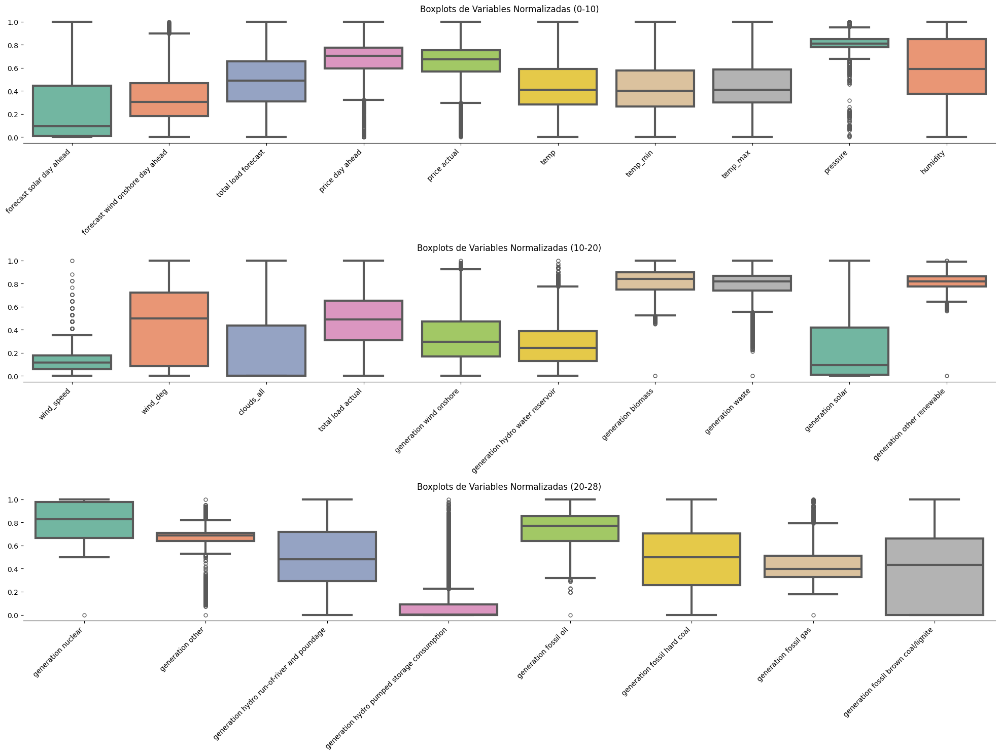

In [ ]:
filtered_data_normalizada = (filtered_data - filtered_data.min())/(filtered_data.max() - filtered_data.min())

# Dividir las columnas en grupos para graficar en varios subplots
num_cols = len(filtered_data_normalizada.columns)
cols_per_plot = 10  # Número de columnas por gráfico

num_plots = (num_cols + cols_per_plot - 1) // cols_per_plot

# Crear subplots
fig, axes = plt.subplots(num_plots, 1, figsize=(20, 5 * num_plots))

for i in range(num_plots):
    start_idx = i * cols_per_plot
    end_idx = min((i + 1) * cols_per_plot, num_cols)

    sns.boxplot(data=filtered_data_normalizada.iloc[:, start_idx:end_idx],
                linewidth=3, palette="Set2", fliersize=5, ax=axes[i])

    axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45, ha='right')
    axes[i].set_title(f"Boxplots de Variables Normalizadas ({start_idx}-{end_idx})")
    sns.despine(left=True, ax=axes[i])

plt.tight_layout()
plt.savefig('boxplot.png')
plt.show()

### Análisis Boxplots

Los gráficos que has mostrado anteriormente son obtenidos luego de normalizar las variables del dataset, es decir, las variables están en un rango de 0 a 1.  

Del gráfico anterior se puede deducir lo siguiente:


- La generación de **biomasa** (`generation biomass`), **nuclear** (`generation nuclear`) y **gas** (`generation fossil gas`) tienen un **rango intercuartil más estrecho**, lo que indica más estabilidad en su generación.

- Se pueden observar posibles valores atípicos en algunas variables, como en **generación nuclear** (`generation nuclear`), **generación solar** (`generation solar`) y **precio de la energía al día siguiente** (`price day ahead`), entre otros.

- La generación de **biomasa** (`generation biomass`), **carbón marrón** (`generation fossil brown coal/lignite`) y **carbón duro** (`generation fossil hard coal`) tienen una distribución relativamente amplia, con algunos valores atípicos. La median está en la mitad de sus rangos intercuartiles, lo que indica una distribución equilibrada entre los valores más bajos y altos.

- La **generación hidroeléctrica con bombeo** (`generation hydro pumped storage consumption`) muestra mayor variabilidad, con una mediana más baja.

- La **generación nuclear** (`generation nuclear`) presenta una distribución más compacta, lo que sugiere menor variabilidad en los datos.

- La **generación solar** tiene una mediana muy baja y algunos valores atípicos, lo que indica que los valores tienden a ser más bajos, con picos esporádicos.

- El **pronóstico de demanda** (`total load forecast`) y la **demanda real** (`total load actual`) tienen una distribución más concentrada.

- **Temperatura** (`temp`, `temp_min`, `temp_max`), **humedad** (`humidity`) y **velocidad del viento** (`wind_speed`) tienen una variabilidad significativa. Por ejemplo, la **humedad** tiene una dispersión más amplia, con varios valores atípicos, mientras que la velocidad del viento muestra una gran amplitud.

- **porcentaje de nubes** (`clouds_all`) presentan una concentración más baja. Esto indica que este factor puede ser más consistentes o predecibles en comparación con otras variables.


## Detección de datos atipicos

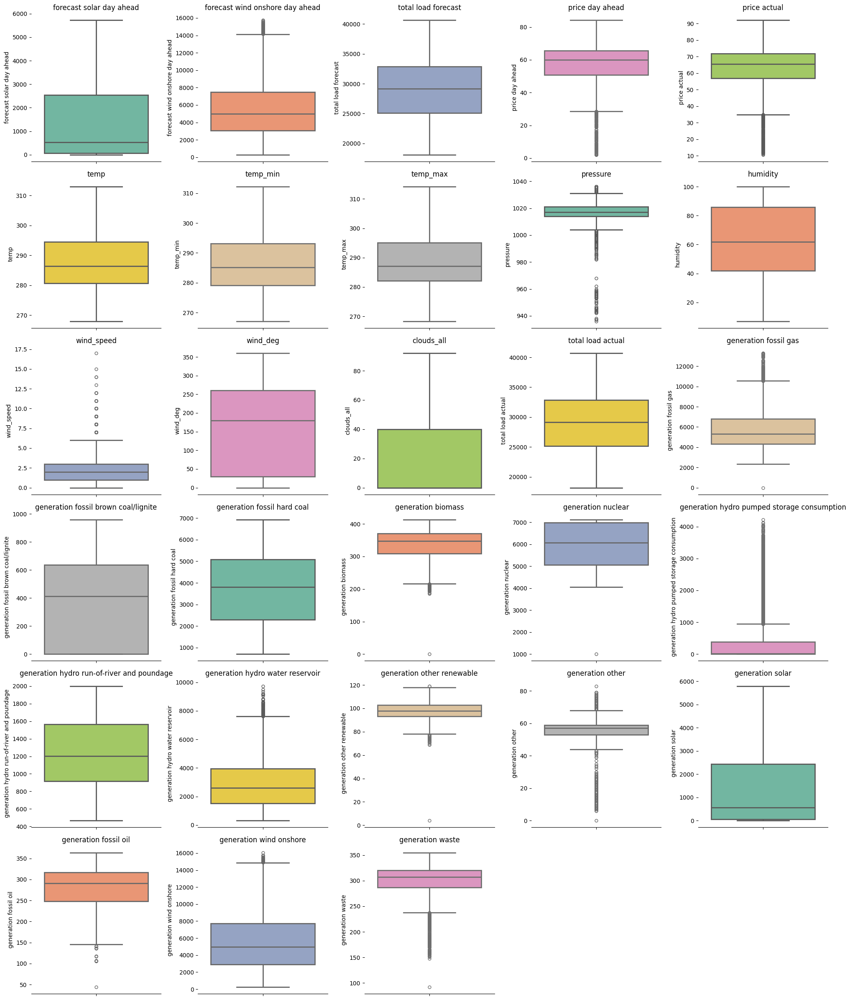

In [ ]:
# Configurar el tamaño de la cuadrícula de subplots
num_vars = len(filtered_data.columns)
cols_per_row = 5  # Cantidad de gráficos por fila
num_rows = (num_vars + cols_per_row - 1) // cols_per_row  # Calcular filas necesarias

# Obtener colores de la paleta
palette = sns.color_palette("Set2", num_vars)  # Genera una paleta de colores con el número de variables

# Crear figura y ejes
fig, axes = plt.subplots(num_rows, cols_per_row, figsize=(20, 4 * num_rows))
axes = axes.flatten()  # Asegurar que axes sea un array unidimensional

# Iterar sobre cada variable y crear un boxplot independiente con color distinto
for i, col in enumerate(filtered_data.columns):
    sns.boxplot(y=filtered_data[col], linewidth=2, color=palette[i], fliersize=5, ax=axes[i])
    axes[i].set_title(col)
    axes[i].set_xlabel('')  # Ocultar etiquetas innecesarias
    sns.despine(left=True, ax=axes[i])

# Ocultar subplots vacíos si el número de variables no llena la cuadrícula
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig('boxplot_individual_colored.png')
plt.show()

### **Análisis de los datos atipicos**  

En el análisis exploratorio de datos, los diagramas de caja (boxplots) nos ayudan a identificar valores atípicos, que se definen generalmente como aquellos datos que están fuera del rango normal de los datos. Sin embargo, la presencia de valores atípicos no siempre implica errores de medición o datos incorrectos, sino que pueden ser **atípicos naturales** dentro del fenómeno estudiado.  

Los **atípicos naturales** son valores extremos dentro de un rango esperado o posible en la distribución de los datos. Su presencia refleja la variabilidad naturales de los datos y aporta información valiosa. Los **atípicos de medición** son valores producto de errores en la recolección, registro o procesamiento de datos. Estos deben ser corregidos o eliminados cuando sea necesario.  

En este caso, todas las variables analizadas se encuentran en rangos posibles [2] (esto se puede notar también en la tabla anterior de los estadisticas de tendencia central de los datos), lo que indica que los valores atípicos identificados por los boxplots no son errores de medición, sino mas bien la variabilidad natural de los datos.  

La eliminación de estos datos podría generar una pérdida de información valiosa, reduciendo la capacidad predictiva y explicativa de cualquier modelo. Estos valores pueden representar casos raros pero reales dentro del conjunto de datos. En muchos contextos, los valores atípicos pueden indicar comportamientos anómalos que son clave para la toma de decisiones, como picos de consumo, eventos raros pero importantes o patrones de comportamiento específicos.  

Dado que estos valores atípicos son naturales y no errores de medición, no se hará eliminación de los mismos, ya que cada dato aporta información útil sobre el comportamiento de los datos.


## Diagramas de violines

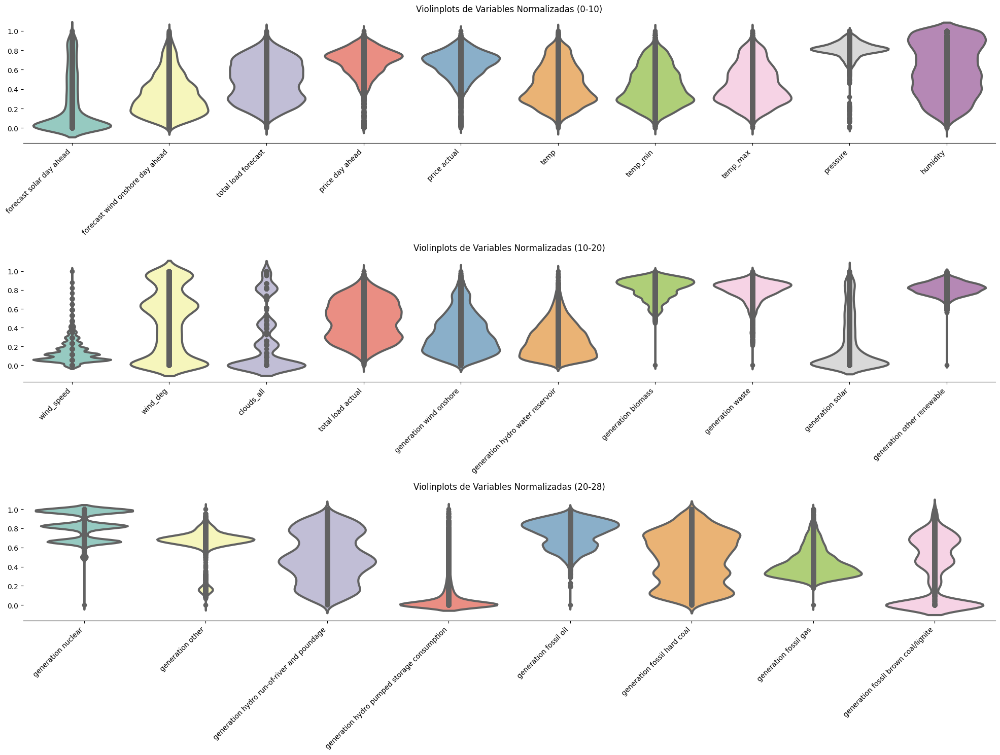

In [ ]:
# Dividir las columnas en grupos para graficar en varios subplots
num_cols = len(filtered_data_normalizada.columns)
cols_per_plot = 10  # Número de columnas por gráfico

num_plots = (num_cols + cols_per_plot - 1) // cols_per_plot

# Crear subplots
fig, axes = plt.subplots(num_plots, 1, figsize=(20, 5 * num_plots))

for i in range(num_plots):
    start_idx = i * cols_per_plot
    end_idx = min((i + 1) * cols_per_plot, num_cols)

    sns.violinplot(data=filtered_data_normalizada.iloc[:, start_idx:end_idx],
                   linewidth=3, palette="Set3", inner="points", ax=axes[i])

    axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45, ha='right')
    axes[i].set_title(f"Violinplots de Variables Normalizadas ({start_idx}-{end_idx})")
    sns.despine(left=True, ax=axes[i])

plt.tight_layout()
plt.savefig('violinplot.png')
plt.show()


### **Análisis Violinplots**

Los gráficos que has mostrado anteriormente son obtenidos luego de normalizar las variables del dataset, es decir, las variables están en un rango de 0 a 1.  

Del gráfico anterior se puede deducir lo siguiente:

- **Generación a partir de biomasa** (`generation biomass`) y **generación a partir de otras renovables** (`generation other renewable`) muestran distribuciones uniformemente dispersas, lo que sugiere que los valores están relativamente equilibrados a lo largo del tiempo.

- **Generación de gas fósil** (`generation fossil gas`) y **generación de petróleo** (`generation fossil oil`) tienen distribuciones más delgadas y concentradas, lo que indica que la mayor parte de los valores están en un rango estrecho con menos variación.

- **Generación nuclear** (`generation nuclear`) y **generación hidroeléctrica de embalse** (`generation hydro water reservoir`) presentan múltiples picos, lo que podría indicar diferentes escenarios operativos dependiendo de factores como la demanda o la disponibilidad de recursos.

- **Generación hidroeléctrica con bombeo** (`generation hydro pumped storage consumption`) muestra una distribución muy concentrada, lo que sugiere que su operación está altamente controlada o limitada a ciertos periodos específicos.

- **Generación eólica onshore** (`generation wind onshore`) y **generación solar** (`generation solar`) presentan distribuciones bimodales, lo que refleja la variabilidad de estas fuentes de energía debido a las fluctuaciones climáticas.

- **Pronóstico de generación eólica onshore** (`forecast wind onshore day ahead`) y **pronóstico de generación solar** (`forecast solar day ahead`) están concentrados en valores bajos, lo que sugiere que la mayor parte del tiempo los pronósticos tienden a estar en niveles bajos o que la capacidad instalada está subutilizada.

- **Generación a partir de desechos** (`generation waste`) y **precios del día siguiente** (`price day ahead`) muestran distribuciones más esparcidas, lo que indica una mayor variabilidad en los datos. En el caso de los **precios de la energía**, esto sugiere grandes fluctuaciones, posiblemente debido a cambios en la oferta y la demanda del mercado eléctrico.


## Histogramas

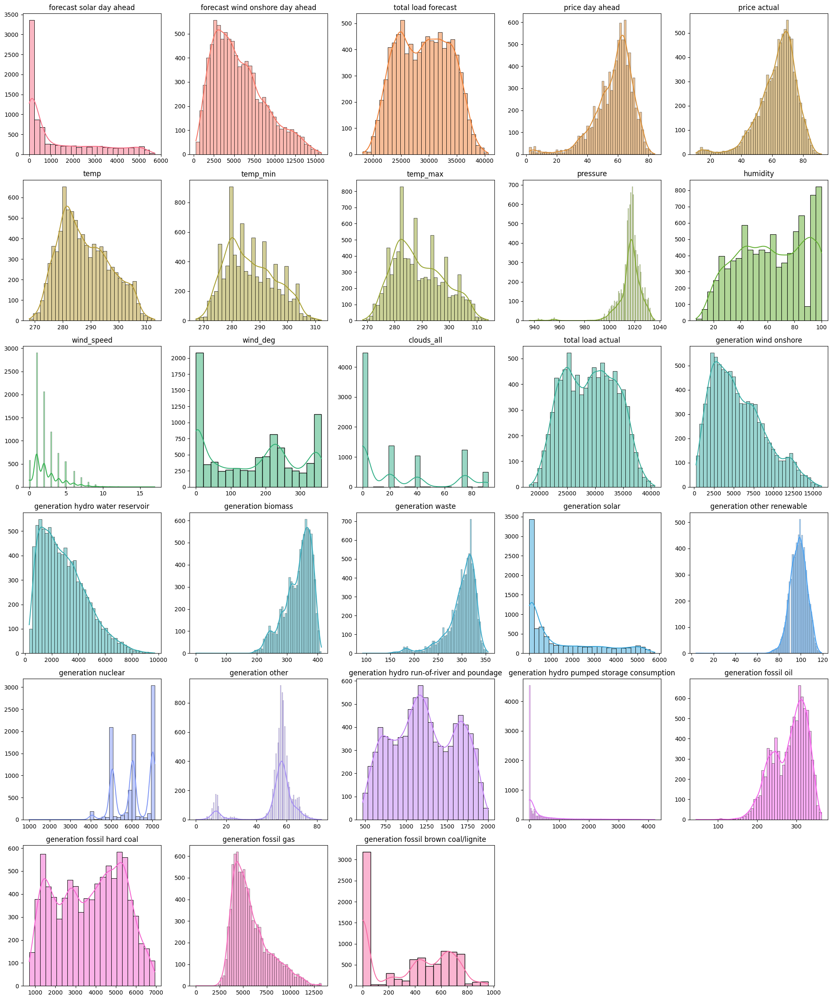

In [ ]:
# Calcular el número de filas y columnas para los subplots
num_cols = 5  # Número de columnas de subplots
num_rows = (len(filtered_data.columns) + num_cols - 1) // num_cols

# Crear la figura y los subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 4 * num_rows))

# Aplanar el array de axes para facilitar la iteración
axes = axes.flatten()

# Iterar sobre las columnas y crear los histogramas
for i, col in enumerate(filtered_data.columns):
    sns.histplot(filtered_data[col], kde=True, ax=axes[i], color=sns.color_palette("husl", len(filtered_data.columns))[i])
    axes[i].set_title(col)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')

# Ocultar los subplots vacíos si hay menos columnas que subplots
for i in range(len(filtered_data.columns), len(axes)):
    axes[i].axis('off')

# Ajustar el espaciado entre los subplots
plt.tight_layout()
plt.savefig('histogramas.png')
plt.show()


### Análisis Histogramas  

Del gráfico anterior se puede deducir lo siguiente:


- Los histogramas de **biomasa** (`generation biomass`), **gas fósil** (`generation fossil gas`), **carbón duro** (`generation fossil hard coal`), **carbón marrón** (`generation fossil brown coal/lignite`) y **petróleo** (`generation fossil oil`) muestran distribuciones variadas. En algunos casos hay alta variabilidad, como en la generación de **gas fósil**, mientras que otros presentan picos más concentrados, como la generación de **biomasa** y **petróleo**.

- La **generación hidroeléctrica** parece estar distribuida entre diferentes formas**, como bombeo (`generation hydro pumped storage aggregated`, `generation hydro pumped storage consumption`), ríos (`generation hydro run-of-river and poundage`), embalses (`generation hydro water reservoir`)** y con la **generación nuclear** (`generation nuclear`) muestra picos concentrados en ciertos valores, lo que sugiere una producción más estable.

- La **generación solar** (`generation solar`) tiene muchos datos concentrados en valores bajos. La **generación eólica** (`generation wind onshore`) y **otras fuentes renovables** muestran distribuciones más amplias, con generación significativa en varios rangos.

- La **Temperatura** (`temp`, `temp_min`, `temp_max`) muestra una distribución bastante uniforme con picos claramente definidos. Se asemeja en gran medida a una distribución normal.

- La **Presión atmosférica** (`pressure`) tiende hacia valores más altos, lo que sugiere que se concentra en un rango limitado de valores.

- La **Humedad** (`humidity`) presenta una distribución más dispersa.
- La **nubosidad** (`clouds_all`) tiene distribución dispersa y concentrada en el extremo inferior, lo que indica que son eventos menos frecuentes.

- **Velocidad del viento** (`wind_speed`) muestra una distribución sesgada hacia valores bajos, lo que indica que en general, las velocidades del viento tienden a ser bajas, con algunos eventos de viento más fuertes en valores discretos.


## Scatter Plot

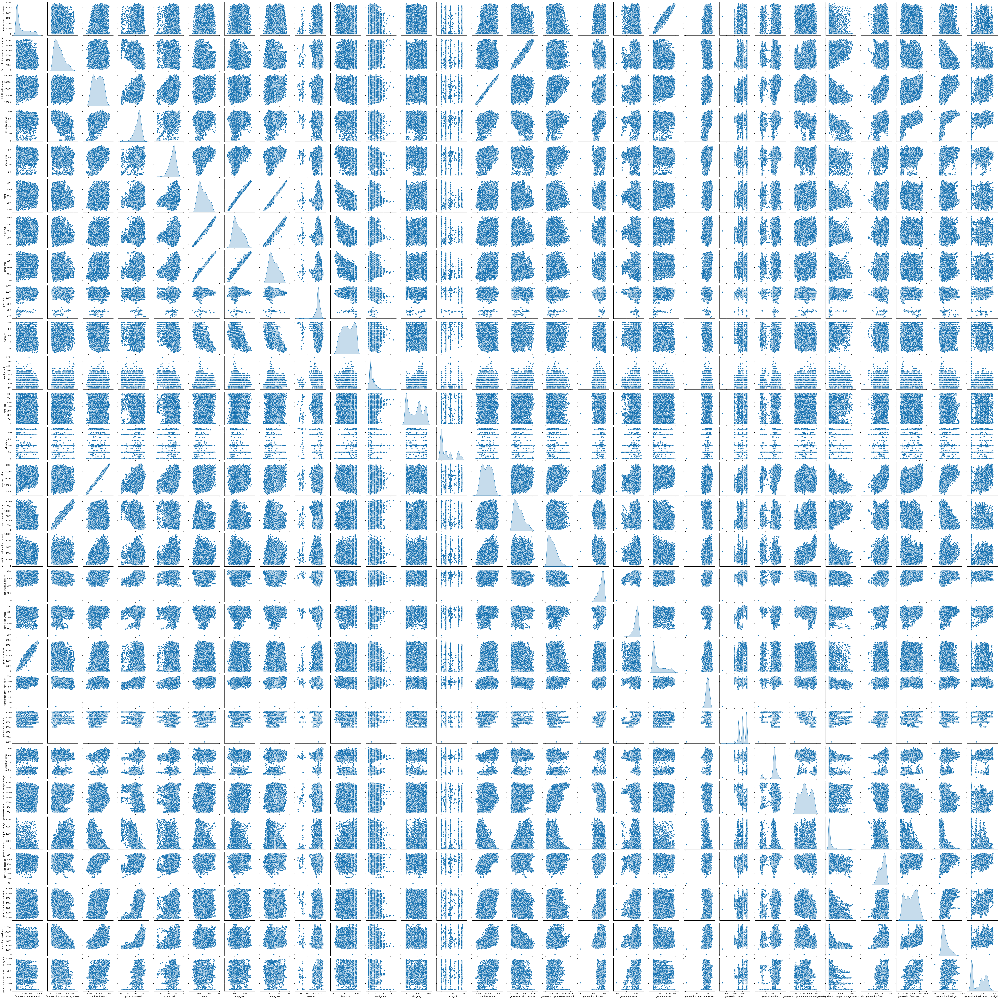

In [ ]:
# Crear la matriz de scatterplots
sns.pairplot(filtered_data, diag_kind='kde')
plt.savefig('scatter_plot.png')
plt.show()

## Grafico de Lineas

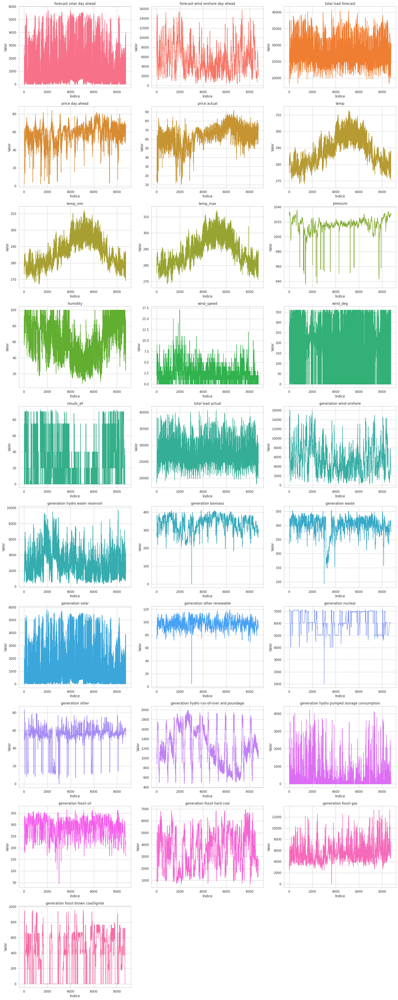

In [ ]:
sns.set(style="whitegrid")

# Crear subplots para cada columna
num_cols = len(filtered_data.columns)
num_plots = (num_cols + 2) // 3  # 3 columnas por fila

fig, axes = plt.subplots(num_plots, 3, figsize=(20, 5 * num_plots))

# Si solo hay una fila, `axes` es un array 1D
if num_plots == 1:
    axes = axes.reshape(1, -1)

# Usar una paleta de colores de Seaborn
palette = sns.color_palette("husl", num_cols)

for i, col in enumerate(filtered_data.columns):
    row = i // 3
    col_idx = i % 3
    ax = axes[row, col_idx]

    # Usar la paleta de colores en el gráfico
    ax.plot(filtered_data.index, filtered_data[col], color=palette[i])
    ax.set_title(col)
    ax.set_xlabel('Índice')
    ax.set_ylabel('Valor')
    ax.grid(True)

# Manejar posibles ejes no utilizados si el número de subplots no llena todas las celdas
for j in range(i + 1, num_plots * 3):
    row = j // 3
    col_idx = j % 3
    fig.delaxes(axes[row, col_idx])

# Ajustar el diseño y mostrar el gráfico
plt.tight_layout()
plt.show()

## Descomposicion Estacional

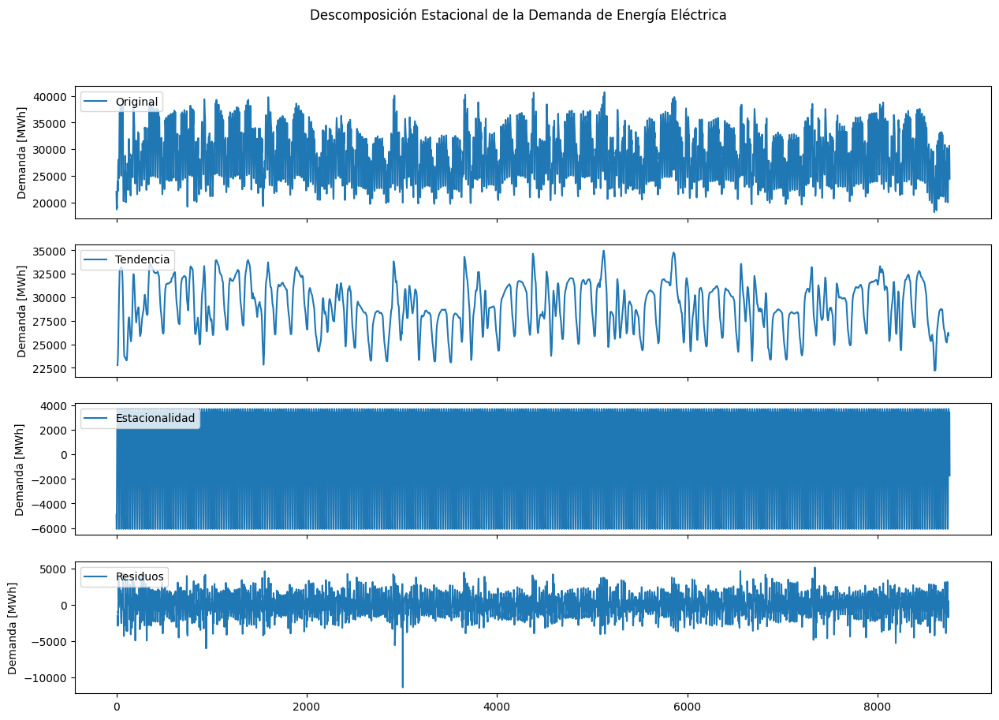

In [45]:
# Identificación de tendencias
filtered_data_aux = pd.concat([time_column, filtered_data], axis=1)
filtered_data_aux = filtered_data_aux.set_index(filtered_data_aux['time'])

data_hour_descomposition = seasonal_decompose(filtered_data['total load actual'], model='additive', period=24)

data_hour_trend = data_hour_descomposition.trend
data_hour_seasonal = data_hour_descomposition.seasonal
data_hour_resid = data_hour_descomposition.resid

fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.suptitle('Descomposición Estacional de la Demanda de Energía Eléctrica')
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(filtered_data['total load actual'], label='Original')
axes[0].legend(loc='upper left')
axes[0].set_ylabel('Demanda [MWh]');

axes[1].plot(data_hour_trend, label='Tendencia')
axes[1].legend(loc='upper left')
axes[1].set_ylabel('Demanda [MWh]');

axes[2].plot(data_hour_seasonal, label='Estacionalidad')
axes[2].legend(loc='upper left')
axes[2].set_ylabel('Demanda [MWh]');

axes[3].plot(data_hour_resid,  label='Residuos')
axes[3].legend(loc='upper left')
axes[3].set_ylabel('Demanda [MWh]');

plt.savefig('descomposition.png')
plt.show()

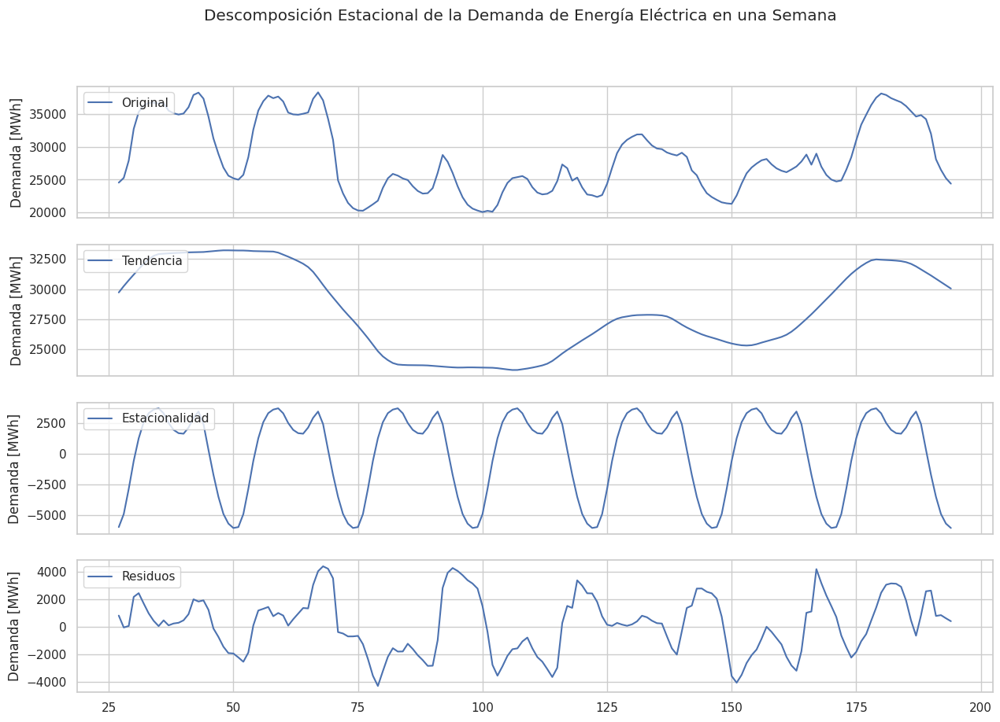

In [ ]:
# Identificación de tendencias
fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.suptitle('Descomposición Estacional de la Demanda de Energía Eléctrica en una Semana')
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(filtered_data['total load actual'][27:195], label='Original')
axes[0].legend(loc='upper left')
axes[0].set_ylabel('Demanda [MWh]');

axes[1].plot(data_hour_trend[27:195], label='Tendencia')
axes[1].legend(loc='upper left')
axes[1].set_ylabel('Demanda [MWh]');

axes[2].plot(data_hour_seasonal[27:195], label='Estacionalidad')
axes[2].legend(loc='upper left')
axes[2].set_ylabel('Demanda [MWh]');

axes[3].plot(data_hour_resid[27:195],  label='Residuos')
axes[3].legend(loc='upper left')
axes[3].set_ylabel('Demanda [MWh]');

plt.savefig('descomposition_semana.png')
plt.show()

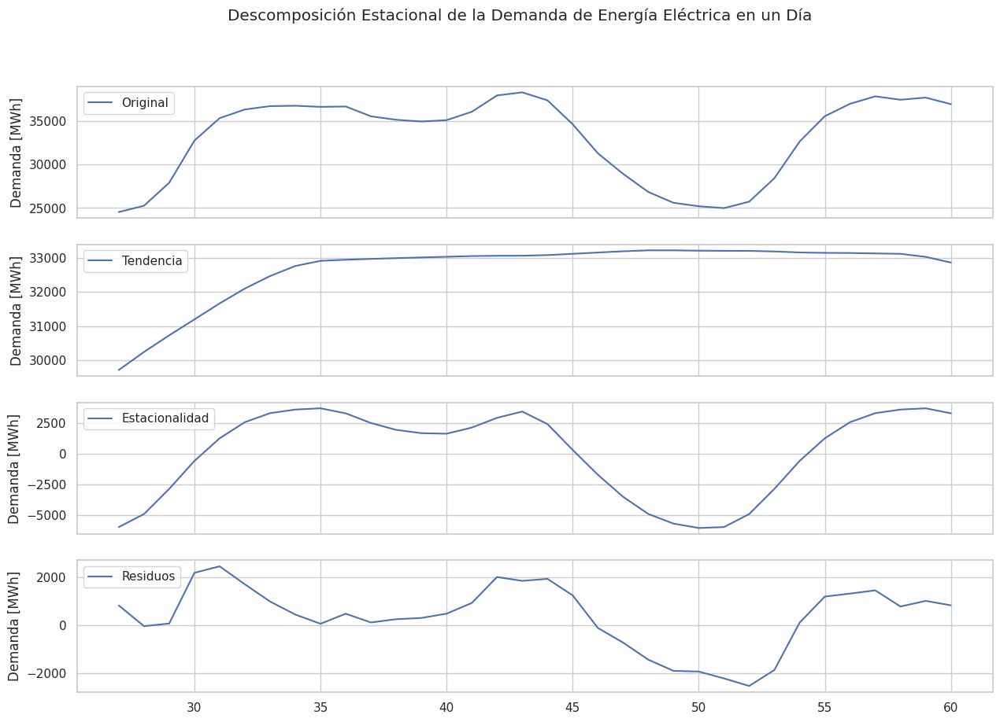

In [ ]:
# Identificación de tendencias
fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.suptitle('Descomposición Estacional de la Demanda de Energía Eléctrica en un Día')
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(filtered_data['total load actual'][27:61], label='Original')
axes[0].legend(loc='upper left')
axes[0].set_ylabel('Demanda [MWh]');

axes[1].plot(data_hour_trend[27:61], label='Tendencia')
axes[1].legend(loc='upper left')
axes[1].set_ylabel('Demanda [MWh]');

axes[2].plot(data_hour_seasonal[27:61], label='Estacionalidad')
axes[2].legend(loc='upper left')
axes[2].set_ylabel('Demanda [MWh]');

axes[3].plot(data_hour_resid[27:61],  label='Residuos')
axes[3].legend(loc='upper left')
axes[3].set_ylabel('Demanda [MWh]');

plt.savefig('descomposition_dia.png')
plt.show()

### **Análisis de la Descomposición Estacional**  

Las gráficas mostradas corresponden a la descomposición de la demanda eléctrica en sus componentes de tendencia, estacionalidad y residuos, con diferentes escalas temporales (larzo plazo, semanal y diaria).  

- **Serie Original**  
  - Se muestra la variabilidad completa de la demanda de energía eléctrica.  
  - En la serie de largo plazo, se observa una alta fluctuación con posibles picos y valles que podrían estar relacionados con cambios estacionales o eventos específicos en el sistema eléctrico.  
  - En la escala semanal, se aprecia un patrón más claro de consumo diario.  
  - En la escala diaria, se identifican ciclos horarios definidos con picos en horarios de alta demanda y valles en momentos de menor consumo.  

- **Tendencia**  
  - En la serie de largo plazo, la tendencia tiene fluctuaciones más suaves, reflejando cambios estructurales en la demanda de energía eléctrica a lo largo del tiempo.  
  - En la escala semanal, se observan variaciones que pueden deberse a diferencias entre días laborales y fines de semana.  
  - En la escala diaria, la tendencia se muestra más estable, con una forma ascendente y descendente que sigue los patrones de consumo a lo largo del día.  

- **Estacionalidad**  
  - En la serie de largo plazo, la componente estacional es muy marcada, lo que indica la presencia de ciclos definidos en la demanda de energía eléctrica.  
  - En la escala semanal, se observan picos recurrentes en ciertos días, posiblemente reflejando hábitos de consumo.  
  - En la escala diaria, los ciclos estacionales corresponden a las horas del día con mayor y menor consumo.  

- **Residuos**  
  - La variabilidad de los residuos indica la presencia de factores no explicados por la tendencia ni la estacionalidad.  
  - En la serie de larzo plazo, los residuos muestran cierta dispersión, lo que sugiere que existen eventos inesperados o fluctuaciones aleatorias en la demanda.  
  - En la escala semanal y diaria, los residuos parecen seguir un comportamiento más estable, con fluctuaciones más contenidas.



## Autocorrelación

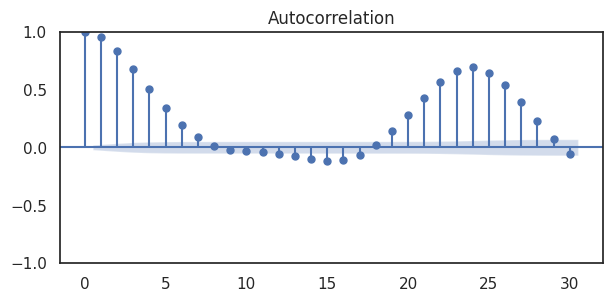

In [ ]:
# Gráfico autocorrelación
fig, ax = plt.subplots(figsize=(7, 3))
plot_acf(filtered_data['total load actual'], ax=ax, lags=30)

plt.savefig('autocorrelacion.png')
plt.show()

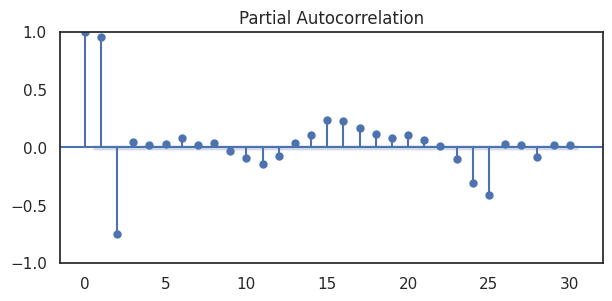

In [ ]:
# Gráfico autocorrelación parcial
fig, ax = plt.subplots(figsize=(7, 3))
plot_pacf(filtered_data['total load actual'], ax=ax, lags=30)
plt.show()

### **Análisis de los Gráficos de Autocorrelación (ACF) y Autocorrelación Parcial (PACF)**  

Los gráficos presentados corresponden al análisis de autocorrelación y autocorrelación parcial de una serie de tiempo de la demanda de energia eléctrica, con el objetivo de identificar patrones y dependencia entre observaciones pasadas.  

- **Análisis del Gráfico de Autocorrelación (ACF)**  
La función de autocorrelación (ACF) mide la correlación entre la serie de tiempo y sus retrasos (lags).  

  - Hay una correlación fuerte y significativa en los primeros retrasos (lags), que disminuye gradualmente.  
  - Se observa un segundo pico de autocorrelación alrededor del lag 24, lo que indica una periodicidad en la serie, probablemente relacionada con un ciclo diario (cada 24 horas).  
  - Después del lag 10, la autocorrelación se vuelve menos significativa, pero vuelve a aumentar alrededor del lag 20-25.  
  - La presencia de un patrón en forma de onda sugiere una estructura cíclica en la serie de tiempo, lo que indica que la demanda de energía sigue una estacionalidad bien definida.  

- **Análisis del Gráfico de Autocorrelación Parcial (PACF)**  
La función de autocorrelación parcial (PACF) muestra la correlación entre la serie y sus retrasos, eliminando el efecto de los retrasos intermedios.  

  - El PACF muestra un pico alto en el primer retardo (lag 1), lo que indica que la demanda actual está fuertemente influenciada por la demanda inmediatamente anterior.  
  - A partir del lag 3 en adelante, la mayoría de los valores se encuentran dentro del intervalo de confianza, excepto algunos lags entre 20 y 25, lo que refuerza la idea de un ciclo estacional.




## Boxplot de Estacionalidad

In [55]:
# Asegúrar de que la columna 'time' es de tipo datetime
filtered_data_aux['time'] = pd.to_datetime(filtered_data_aux['time'])

# Extraer horas, días de la semana y meses
filtered_data_aux['hour'] = filtered_data_aux['time'].dt.hour
filtered_data_aux['dayofweek'] = filtered_data_aux['time'].dt.dayofweek  # Monday=0, Sunday=6
filtered_data_aux['month'] = filtered_data_aux['time'].dt.month

filtered_data_aux.head()

,time,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,price day ahead,price actual,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,clouds_all,total load actual,generation fossil gas,generation fossil brown coal/lignite,generation fossil hard coal,generation biomass,generation nuclear,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation other renewable,generation other,generation solar,generation fossil oil,generation wind onshore,generation waste,hour,dayofweek,month
time,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,2018-01-01 00:00:00,0.0,11527.0,22688.0,4.74,19.02,279.58,279.15,280.15,1030,65,4,280,0,22009.0,3269.0,0.0,959.0,275.0,7057.0,2115.0,1046.0,799.0,77.0,51.0,9.0,191.0,11156.0,238.0,0,0,1
2018-01-01 01:00:00,2018-01-01 01:00:00,1.0,10749.0,21521.0,3.66,17.90,280.58,280.15,281.15,1030,61,5,280,0,20589.0,3541.0,0.0,1014.0,278.0,7058.0,2037.0,1048.0,898.0,79.0,51.0,9.0,191.0,9437.0,236.0,1,0,1
2018-01-01 02:00:00,2018-01-01 02:00:00,4.0,8095.0,20294.0,2.30,20.88,280.13,279.15,281.15,1030,89,5,280,0,19547.0,3450.0,0.0,1043.0,278.0,7061.0,2126.0,1021.0,714.0,79.0,52.0,9.0,191.0,6474.0,238.0,2,0,1
2018-01-01 03:00:00,2018-01-01 03:00:00,6.0,6391.0,19489.0,2.30,18.83,279.01,278.15,280.15,1030,89,5,250,0,18871.0,3318.0,0.0,1063.0,279.0,7066.0,2580.0,1033.0,661.0,79.0,51.0,9.0,191.0,6329.0,239.0,3,0,1
2018-01-01 04:00:00,2018-01-01 04:00:00,4.0,6376.0,19179.0,2.06,15.80,278.44,277.15,280.15,1031,56,4,230,0,18688.0,3334.0,0.0,1054.0,278.0,7069.0,2544.0,1013.0,612.0,77.0,51.0,9.0,191.0,6172.0,238.0,4,0,1


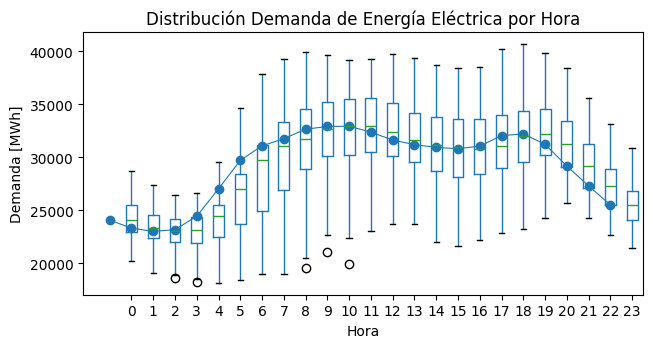

In [59]:
# Boxplot para estacionalidad hora
fig, ax = plt.subplots(figsize=(7, 3.5))
filtered_data_aux.boxplot(column='total load actual', by='hour', ax=ax)
filtered_data_aux.groupby('hour')['total load actual'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('Demanda [MWh]')
ax.set_xlabel('Hora')
ax.set_title('Distribución Demanda de Energía Eléctrica por Hora')
fig.suptitle('')

plt.savefig('distr_demanda_por_hora.png')
plt.show()

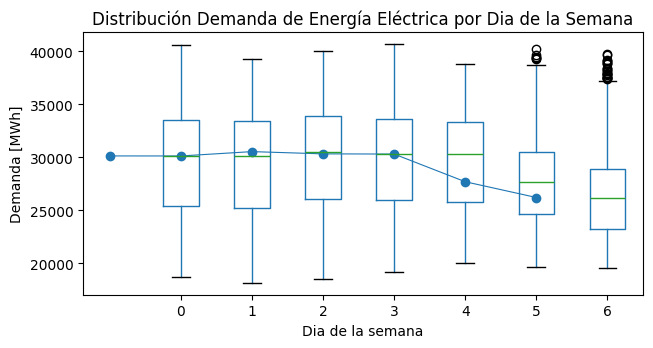

In [63]:
# Boxplot para estacionalidad dia de la semana
fig, ax = plt.subplots(figsize=(7, 3.5))
filtered_data_aux.boxplot(column='total load actual', by='dayofweek', ax=ax)
filtered_data_aux.groupby('dayofweek')['total load actual'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('Demanda [MWh]')
ax.set_xlabel('Dia de la semana')
ax.set_title('Distribución Demanda de Energía Eléctrica por Dia de la Semana')
fig.suptitle('')

plt.savefig('distr_demanda_por_dia_semana.png')
plt.show()

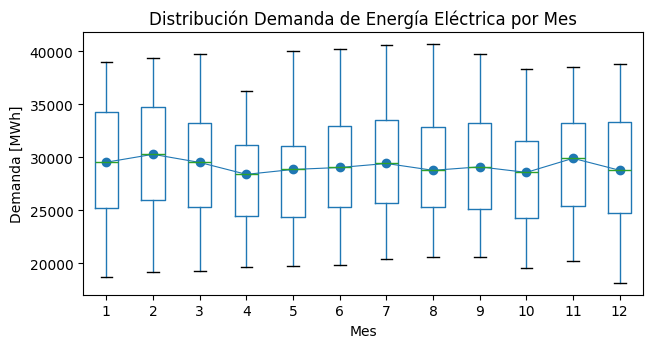

In [65]:
# Boxplot para estacionalidad mes
fig, ax = plt.subplots(figsize=(7, 3.5))
filtered_data_aux.boxplot(column='total load actual', by='month', ax=ax)
filtered_data_aux.groupby('month')['total load actual'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('Demanda [MWh]')
ax.set_xlabel('Mes')
ax.set_title('Distribución Demanda de Energía Eléctrica por Mes')
fig.suptitle('')

plt.savefig('distr_demanda_por_mes.png')
plt.show()

### **Análisis de los Gráficos Boxplot de la Demanda de Energía Eléctrica**  

Estos gráficos de caja permiten visualizar la distribución de la demanda de energía eléctrica en diferentes escalas temporales: por hora, por día de la semana y por mes.  

- **Distribución de la Demanda de Energía Eléctrica por Hora**    
  - Se observa una variación horaria en la demanda de energía.  
  - Las horas de la madrugada (0-5) presentan menor demanda y mayor variabilidad.  
  - A partir de las 5-6 AM, la demanda comienza a aumentar y alcanza su punto máximo entre las 10 AM y las 6 PM.  
  - Después de las 6 PM, la demanda empieza a descender progresivamente.  
  - Hay algunos valores atípicos en la madrugada y en la mañana, lo que sugiere eventos esporádicos de demanda inusualmente alta o baja.  

- **Distribución de la Demanda de Energía Eléctrica por Día de la Semana**  
  - La mediana de la demanda es relativamente estable entre los primeros días de la semana.  
  - A partir del jueves y viernes, se observa una ligera tendencia decreciente.  
  - Los sábados y domingos tienen menor demanda y mayor dispersión, con varios valores atípicos en la parte superior.  
  - Los valores atípicos indican que algunos días tienen picos de consumo significativamente altos.  

- **Distribución de la Demanda de Energía Eléctrica por Mes**   
  - La demanda de energía se mantiene relativamente estable a lo largo del año, con pequeñas fluctuaciones entre los meses.  
  - No se observa una estacionalidad fuerte, aunque hay meses con mayor dispersión en la demanda.  
  - Hay valores atípicos en algunos meses, indicando eventos inusuales en el consumo energético.





## Media Movil o Suavizado

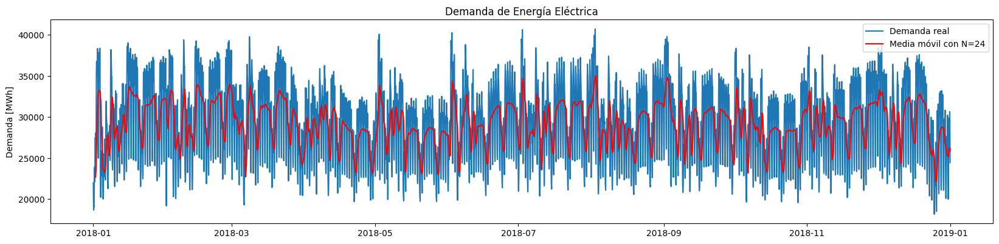

In [72]:
# Crear columna con la media movil
filtered_data_aux['MA_total load actual'] = filtered_data_aux.loc[:, 'total load actual'].rolling(window = 24).mean()

plt.figure(figsize = (20,20));
plt.subplot(4,1,1)
plt.plot('time', 'total load actual', data = filtered_data_aux, label = 'Demanda real', color='tab:blue');
plt.plot('time', 'MA_total load actual', data = filtered_data_aux, label = 'Media móvil con N=24', color = 'red');
plt.title('Demanda de Energía Eléctrica');
plt.ylabel('Demanda [MWh]');
plt.legend()

plt.show()

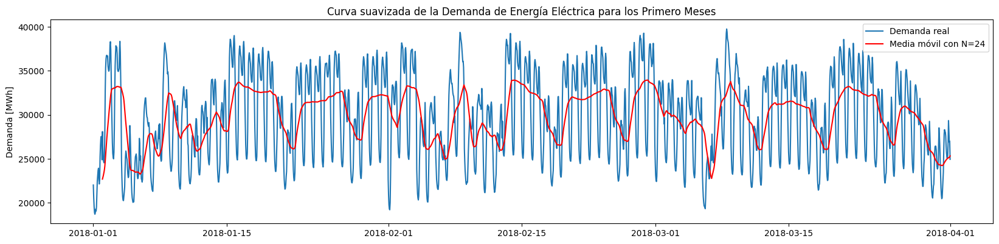

In [76]:
plt.figure(figsize = (20,20));
plt.subplot(4,1,1)
plt.plot('time', 'total load actual', data = filtered_data_aux[0:2160], label = 'Demanda real', color='tab:blue');
plt.plot('time', 'MA_total load actual', data = filtered_data_aux[0:2160], label = 'Media móvil con N=24', color = 'red');
plt.title('Curva suavizada de la Demanda de Energía Eléctrica para los Primero Meses');
plt.ylabel('Demanda [MWh]');
plt.legend()

### **Análisis de la Media Movil de la Demanda de Energía Eléctrica**  

Los gráficos presentados muestran la evolución de la demanda de energía eléctrica a lo largo del tiempo, junto con una media móvil suavizada para identificar tendencias y patrones en la demanda de energía eléctrica.

- **Demanda de Energía Eléctrica a lo Largo Plazo**  
  - La serie de tiempo de la demanda eléctrica (línea azul) presenta una gran variabilidad con picos y valles bien definidos.
  - La media móvil con \( N = 24 \) (línea roja) suaviza la serie y permite observar la tendencia general de la demanda.
  - Se observa un patrón cíclico recurrente, lo que indica que la demanda de energía eléctrica tiene una estacionalidad marcada.
  - Existen picos de alta demanda en ciertos periodos, que pueden estar asociados a factores como cambios estacionales, aumentos en la actividad económica u otro eventos que deben ser analizados.

- **Demanda de Energía en los Primeros Meses**  
  - Este gráfico se enfocada en un período más corto, permitiendo ver la variabilidad de la demanda en una escala más detallada.
  - La demanda tiene fluctuaciones diarias significativas, con picos regulares que indican un patrón de consumo repetitivo.
  - La media móvil (línea roja) permite ver la tendencia suavizada y confirma la presencia de ciclos regulares en la demanda.
  - Se pueden notar caídas abruptas en la demanda en ciertos momentos, lo que podría estar relacionado con eventos específicos o cambios en la operación del sistema eléctrico.


# Reducción de dimensionalidad

## Test Estadisticos

### Multinormalidad individual

In [ ]:
# Realizar la prueba de Shapiro-Wilk para cada variable
shapiro_results = {col: shapiro(filtered_data[col]) for col in filtered_data.columns}

# Crear un DataFrame para mostrar los resultados
shapiro_df = pd.DataFrame(shapiro_results, index=['W-statistic', 'p-value']).T

shapiro_df

,W-statistic,p-value
forecast solar day ahead,0.799233,1.135278e-73
forecast wind onshore day ahead,0.948492,7.019922e-48
total load forecast,0.976045,7.189360e-36
price day ahead,0.913965,6.158102e-57
price actual,0.937445,3.244741e-51
temp,0.971578,2.140031e-38
temp_min,0.971966,3.439023e-38
temp_max,0.970928,9.757063e-39
pressure,0.776416,5.902682e-76
humidity,0.953476,3.521440e-46


In [ ]:
alpha = 0.05

# Decisión sobre el coeficiente de correlación a usar
# Si todas las variables tienen p-values > 0.05, podemos usar Pearson, de lo contrario, Spearman
if all(shapiro_df['p-value'] > alpha):
    corr_method = 'pearson'
else:
    corr_method = 'spearman'

print(f"Se utilizará el coeficiente de correlación: {corr_method}")

Se utilizará el coeficiente de correlación: spearman


#### **Resultados del Test de Normalidad**

Este test evalúa si cada **variable individualmente sigue una distribución normal**.  

La normalidad es un supuesto importante en muchas técnicas estadísticas, ya que garantiza que los resultados obtenidos en la reducción de dimensionalidad sean interpretables bajo los supuestos empleados.  

En este caso, se empleó el **test de Shapiro-Wilk** [3], que permite verificar la **normalidad** en cada una de las variables.  

- Un **p-valor mayor a 0.05** indica que **no se rechaza la hipótesis de normalidad**, lo que sugiere que la variable **sigue una distribución normal**.

A partir de los valores obtenidos, se puede notar que **ninguna de las variables cumple con el test de normalidad univariada**.  

Por lo tanto, en la **matriz de correlación** que se realizará, se debe utilizar un coeficiente que no tenga como supuesto la normalidad de los datos, como por ejemplo **Spearman** [4].


### Especificidad Bartlett

In [ ]:
# Realizar el Test de Bartlett
bartlett_test_stat, bartlett_p_value = calculate_bartlett_sphericity(filtered_data)

alpha = 0.05

# Imprimir e interpretar los resultados de Bartlett
print("Bartlett Test Statistic:", bartlett_test_stat)
print("Bartlett p-value:", bartlett_p_value)
print()
if bartlett_p_value < alpha:
    print("Se rechaza la hipótesis nula del Test de Bartlett: La matriz de correlación no es una matriz identidad, lo que sugiere que las variables están correlacionadas.")
else:
    print("No se rechaza la hipótesis nula del Test de Bartlett: La matriz de correlación podría ser una matriz identidad, lo que sugiere que las variables no están correlacionadas.")

Bartlett Test Statistic: 316967.2813640901
Bartlett p-value: 0.0

Se rechaza la hipótesis nula del Test de Bartlett: La matriz de correlación no es una matriz identidad, lo que sugiere que las variables están correlacionadas.


#### **Resultados del Test de Especificidad de Barlett**

La **prueba de Bartlett** [6] es fundamental para determinar si las correlaciones entre las variables son suficientemente grandes para justificar el uso de una técnica de reducción de dimensionalidad.  

Esta prueba evalúa la hipótesis de que la matriz de correlaciones es una matriz de identidad, lo que implicaría que no hay correlación entre las variables.  

Un **p-valor menor a 0.05** indica que las correlaciones son **significativas**, lo cual es un requisito previo para aplicar técnicas como: **Análisis de Componentes Principales (PCA)** o **Análisis Factorial**

Dado que el **p-valor es menor a 0.05**, se rechaza la hipótesis nula del test de Bartlett. Por lo tanto, la matriz de correlación no es una matriz identidad, lo que sugiere que las variables están correlacionadas.


### KMO

In [ ]:
# Realizar el Test de Kaiser-Meyer-Olkin (KMO)
kmo_all, kmo_model = calculate_kmo(filtered_data)

# Imprimir e interpretar los resultados de KMO
print("KMO Test Value:", kmo_model)
print()
if kmo_model >= 0.6:
    print("El valor KMO es aceptable para el análisis factorial.")
else:
    print("El valor KMO es bajo para el análisis factorial, lo que sugiere que los datos pueden no ser adecuados para este análisis.")

KMO Test Value: 0.7685988069845989

El valor KMO es aceptable para el análisis factorial.


#### **Resultados del Indice KMO**

El **índice KMO** [7] mide la adecuación de la muestra para el **análisis factorial**, evaluando la proporción de varianza compartida entre las variables en comparación con la varianza específica.

Un valor de **KMO > 0.7** se considera adecuado para continuar con la reducción de dimensionalidad. Un valor de **KMO < 0.5** indica que los datos no son apropiados para este tipo de análisis.

Dado que el **p-valor es mayor a 0.05**, se acepta la hipótesis nula del test KMO. Por lo tanto, la matriz de datos es aceptable para un análisis factorial.


## Matriz de Varianza-Covarianza y Correlacion

### **Análisis de Varianza-Covarianza y Correlación**

El primer paso para comprender las relaciones entre las variables del conjunto de datos es calcular las matrices de varianza-covarianza y correlación.  

Estas matrices permiten identificar la magnitud y dirección de las correlaciones entre las variables, proporcionando una visión inicial sobre la estructura de dependencia subyacente en los datos.  

A partir del análisis de estas matrices, se pueden detectar patrones de correlación, los cuales serán esenciales para los análisis posteriores.


In [ ]:
# Calcular la matriz de varianza-covarianza y la matriz de correlación utilizando el método determinado
cov_matrix = filtered_data.cov() # type: ignore

corr_matrix = filtered_data.corr(method=corr_method) # type: ignore

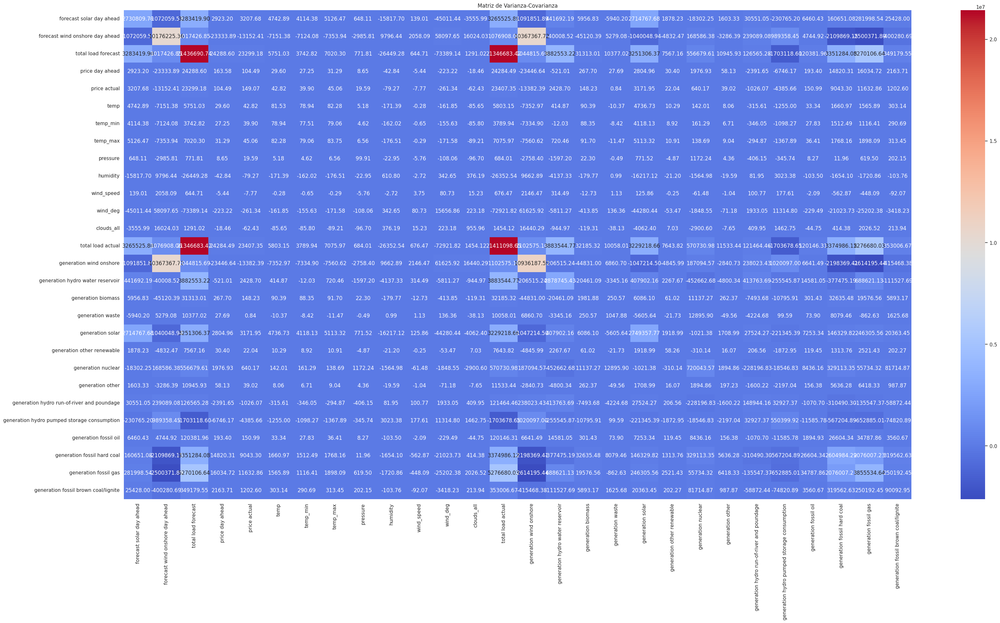

In [ ]:
# Configurar el estilo de los gráficos
sns.set(style="white")

# Crear la figura para la matriz de varianza-covarianza
plt.figure(figsize=(40, 20))
sns.heatmap(cov_matrix, annot=True, cmap='coolwarm', fmt='.2f', cbar=True)
plt.title('Matriz de Varianza-Covarianza')
plt.savefig('matriz_covarianza.png')
plt.show()

### **Matriz de Correlación**

Como se mencionó en el resultado del **test de normalidad univariada**, dado que las variables no presentan normalidad, la matriz de correlación se construyó utilizando el coeficiente de Spearman.


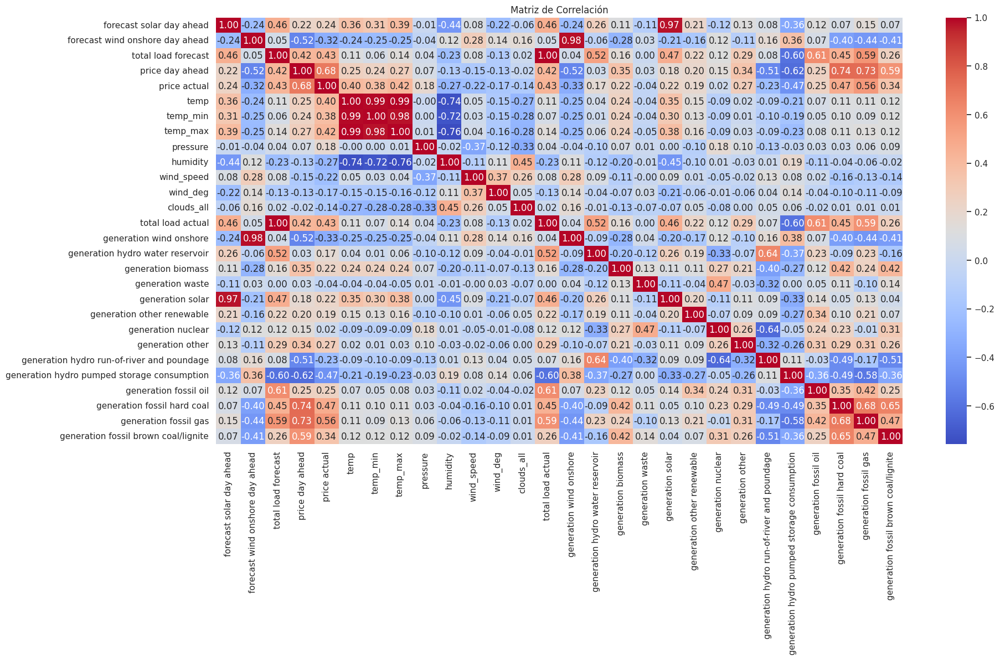

In [ ]:
# Crear la figura para la matriz de correlación
plt.figure(figsize=(20, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', cbar=True)
plt.title('Matriz de Correlación')
plt.savefig('matriz_correlacion.png')
plt.show()

### **Variables sin correlación**
Al establecer un **umbral de significancia** para los coeficientes de correlación de **0.7**, se puede notar que existen algunas variables que no presentan correlación con ninguna otra variable del conjunto de datos.

In [ ]:
# Ajustar el umbral de significancia para los coeficientes de correlación a 0.7
threshold = 0.7

# Crear un diccionario para almacenar las variables sin correlaciones significativas
no_significant_correlations = {}

# Iterar sobre cada variable en la matriz de correlación de Spearman
for column in corr_matrix.columns:
    # Excluir la diagonal (correlación de la variable consigo misma)
    significant_correlations = corr_matrix[column].drop(column).abs() > threshold
    # Si ninguna correlación es significativa, agregar la variable al diccionario
    if not significant_correlations.any():
        no_significant_correlations[column] = significant_correlations.sum()

# Mostrar las variables sin correlaciones significativas
no_significant_correlations

{'price actual': 0,
 'pressure': 0,
 'wind_speed': 0,
 'wind_deg': 0,
 'clouds_all': 0,
 'generation hydro water reservoir': 0,
 'generation biomass': 0,
 'generation waste': 0,
 'generation other renewable': 0,
 'generation nuclear': 0,
 'generation other': 0,
 'generation hydro run-of-river and poundage': 0,
 'generation hydro pumped storage consumption': 0,
 'generation fossil oil': 0,
 'generation fossil brown coal/lignite': 0}

In [ ]:
# Total de variables sin correlaciones significativas
len(no_significant_correlations.keys())

15

En total, se identificaron **15 variables** que representan **un poco más del 50%** del total de variables del conjunto de datos.  

Dado que el objetivo principal de las técnicas de reducción de dimensionalidad es eliminar estructuras de dependencia entre las variables, aquellas que no presentan correlación con ninguna otra serán excluidas del análisis.  

Si estas variables se incluyeran en la reducción de dimensionalidad, generarían componentes específicos para ellas mismas, lo que introduciría ruido en el análisis e implementación.

De estas variables, es importante notar que la **nubosidad** (`clouds_all`) no tiene correlación con la **generación solar** (`generation solar`), lo cual se aleja de lo que se suponía con los análisis iniciales de la sección de análisis de datos. Algo similar sucede con la **velocidad del viento** (`wind_speed`) y la **generación eólica** (`generation wind onshore`), ya que se puede intuir fácilmente que si la velocidad del viento es mayor, debería haber mayor **generación eólica**, pero en este caso no hubo correlación.  

Ambos casos, el de la **nubosidad** y la **generación solar**, y l**a generación eólica** y la **velocidad del viento**, pueden deberse a que, por lo general, las fuentes de generación están alejadas de las ciudades principales. Como se explicó en la sección l contexto de la base de datos, las variables climáticas son tomadas solo de 5 ciudades, por lo que se puede estar perdiendo información relevante sobre estas variables en los sitios donde están instaladas las fuentes de generación mencionadas.



### **Variables con correlación**
Siguiendo el mismo criterio del **umbral de significancia** para los coeficientes de correlación de **0.7**, se puede notar que algunas variables presentan correlación con otras variables del conjunto de datos.  

In [ ]:
# Crear un diccionario para almacenar las variables con correlaciones significativas
significant_correlations = {}

# Iterar sobre cada variable en la matriz de correlación de Spearman
for column in corr_matrix.columns:
    # Excluir la diagonal (correlación de la variable consigo misma)
    significant_correlations_values = corr_matrix[column].drop(column).abs() > threshold
    # Si alguna correlación es significativa, agregar la variable al diccionario
    if significant_correlations_values.any():
        significant_correlations[column] = significant_correlations_values.sum()

# Mostrar las variables con correlaciones significativas
significant_correlations

{'forecast solar day ahead': 1,
 'forecast wind onshore day ahead': 1,
 'total load forecast': 1,
 'price day ahead': 2,
 'temp': 3,
 'temp_min': 3,
 'temp_max': 3,
 'humidity': 3,
 'total load actual': 1,
 'generation wind onshore': 1,
 'generation solar': 1,
 'generation fossil hard coal': 1,
 'generation fossil gas': 1}

In [ ]:
list(significant_correlations.keys())

['forecast solar day ahead',
 'forecast wind onshore day ahead',
 'total load forecast',
 'price day ahead',
 'temp',
 'temp_min',
 'temp_max',
 'humidity',
 'total load actual',
 'generation wind onshore',
 'generation solar',
 'generation fossil hard coal',
 'generation fossil gas']

In [ ]:
# Total de variables con correlaciones significativas
len(significant_correlations.keys())

13

In [ ]:
# Crear una lista para almacenar las variables con correlaciones significativas y sus correlaciones
rows = []

# Iterar sobre cada variable en la matriz de correlación de Spearman
for column in corr_matrix.columns:
    # Excluir la diagonal (correlación de la variable consigo misma)
    correlations = corr_matrix[column].drop(column)

    # Filtrar las correlaciones que son mayores al umbral en valor absoluto
    significant_correlations_values = correlations[correlations.abs() > threshold]

    # Si alguna correlación es significativa, agregar los detalles a la lista
    for var, corr in significant_correlations_values.items():
        rows.append({
            'Variable': column,
            'Correlates with': var,
            'Correlation': corr,
            'Sign': 'positive' if corr > 0 else 'negative'
        })

# Convertir la lista de diccionarios en un DataFrame
significant_correlations_df = pd.DataFrame(rows)

significant_correlations_df

,Variable,Correlates with,Correlation,Sign
0,forecast solar day ahead,generation solar,0.974508,positive
1,forecast wind onshore day ahead,generation wind onshore,0.982079,positive
2,total load forecast,total load actual,0.996697,positive
3,price day ahead,generation fossil hard coal,0.742168,positive
4,price day ahead,generation fossil gas,0.734270,positive
5,temp,temp_min,0.992602,positive
6,temp,temp_max,0.994854,positive
7,temp,humidity,-0.740727,negative
8,temp_min,temp,0.992602,positive
9,temp_min,temp_max,0.979003,positive


En total, **14 variables** tienen una **correlación significativa** con otras variables del conjunto de datos. De estas variables, se puede identificar que:

El **pronóstico de generación eólica terrestre** (`forecast wind onshore day ahead`) con la **generación eólica terrestre** (`generation wind onshore`), el **pronóstico de generación solar** (`forecast solar day ahead`) con la **generación solar** (`generation solar`) y el **pronóstico de la demanda** (`total load forecast`) con la **demanda real** del sistema (`total load actual`). Presentan altas correlaciones entre ellas, lo cual sugiere que los pronósticos que hace el operador del sistema sobre estas variables tienen un gran grado de precisión. Esto se complementa con lo ya dicho en los análisis de los gráficos y medidas de tendencia central mostrados en la sección de análisis de datos.  

En cuanto a las temperaturas (`temp`, `temp_min`, `temp_max`), también presentan un alto grado de correlación, lo cual es algo intuitivo, ya que si la temperatura media de la hora sube, deberían también subir la temperatura mínima y máxima.  

Las correlaciones más importantes para este análisis son las que se presentan con el **precio de la energía** (`price actual`) y su pronóstico (`price actual ahead`), que presentan correlaciones positivas con la **generación a gas** (`generation fossil gas`) y la **generación hidroeléctrica de embalse** (`generation hydro water reservoir`). Esto indica que estas fuentes de generación, al ser más utilizadas, son las que determinan en gran medida los precios de la energía del sistema.



## Aplicar Análisis de Componentes Principales y Análisis Factorial

Para aplicar el **Análisis de Componentes Principales (PCA)** y el **Análisis Factorial (AF)**, es necesario realizar una normalización o estandarización de las variables. Esto se hace con el fin de evitar que las diferentes magnitudes de las variables influyan en el análisis.

Teniendo esto en cuenta, se proceden a aplicar ambas técnicas sobre el conjunto de datos estandarizados, eliminando las variables que no tienen correlaciones significativa.


In [ ]:
# Normalizar los datos utilizando Standar Scaling
scaler = StandardScaler()
normalized_data = scaler.fit_transform(filtered_data[list(significant_correlations.keys())])
normalized_df = pd.DataFrame(normalized_data, columns=filtered_data[list(significant_correlations.keys())].columns)

In [ ]:
normalized_df.head()

,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,price day ahead,temp,temp_min,temp_max,humidity,total load actual,generation wind onshore,generation solar,generation fossil hard coal,generation fossil gas
0,-0.844386,1.856242,-1.378222,-4.109689,-0.918218,-0.848388,-0.954959,0.095227,-1.525006,1.685074,-0.822598,-1.693888,-1.298493
1,-0.843780,1.612342,-1.630289,-4.194135,-0.807460,-0.734795,-0.845682,-0.066631,-1.831904,1.165236,-0.822598,-1.659809,-1.159960
2,-0.841965,0.780325,-1.895316,-4.300475,-0.857301,-0.848388,-0.845682,1.066378,-2.057106,0.269204,-0.822598,-1.641841,-1.206308
3,-0.840755,0.246129,-2.069193,-4.300475,-0.981351,-0.961982,-0.954959,1.066378,-2.203207,0.225355,-0.822598,-1.629448,-1.273537
4,-0.841965,0.241426,-2.136152,-4.319241,-1.044483,-1.075575,-0.954959,-0.268954,-2.242758,0.177877,-0.822598,-1.635025,-1.265388


### PCA

In [ ]:
# Realizar el PCA
pca_filtered_data = PCA()
pca_filtered_data.fit(normalized_df)

pca_results = pca_filtered_data.transform(normalized_df)

# Valores y vectores propios
pca_values = pca_filtered_data.explained_variance_
pca_vectors = pca_filtered_data.components_

In [ ]:
print("Valores Propios (PCA):", pca_values)

print()
print("Vectores Propios (PCA):\n", pca_vectors)

Valores Propios (PCA): [5.03900521e+00 2.90993518e+00 2.33766511e+00 1.48680936e+00
 4.04203519e-01 3.06979848e-01 2.65443657e-01 2.06653479e-01
 1.67485480e-02 1.46648072e-02 8.84985510e-03 3.54630080e-03
 9.79476923e-04]

Vectores Propios (PCA):
 [[ 2.67149458e-01 -2.33863564e-01  2.48676999e-01  2.86064207e-01
   3.40915361e-01  3.28558922e-01  3.47897058e-01 -3.00674191e-01
   2.48505912e-01 -2.31951344e-01  2.64938562e-01  2.31127843e-01
   2.35553187e-01]
 [-5.67477371e-02 -1.40105351e-01  2.68430125e-01  3.03579555e-01
  -3.34262153e-01 -3.42353252e-01 -3.25260854e-01  3.05691588e-01
   2.68363580e-01 -1.40635772e-01 -6.18649992e-02  3.66446261e-01
   3.93507852e-01]
 [ 2.79777157e-01  4.59709126e-01  4.16204950e-01 -1.88601410e-01
  -7.05555154e-02 -9.59399214e-02 -5.74630122e-02 -7.38194709e-02
   4.16843852e-01  4.59285020e-01  2.82068579e-01 -1.13933723e-01
  -3.76330258e-02]
 [ 5.35344053e-01 -2.96973146e-01 -1.36126098e-01 -1.14273048e-01
  -1.97967143e-01 -2.03632551e-01 

In [ ]:
list_columns = list(normalized_df.columns)

# Crear un DataFrame para los valores propios
pca_values_df = pd.DataFrame({
    'Eigenvalue': pca_values
}, index=[f'Componente_{i+1}' for i in range(pca_vectors.shape[1])])

# Crear un DataFrame para los vectores propios
pca_vectors_df = pd.DataFrame(pca_vectors, columns=list_columns, index=[f'Componente_{i+1}' for i in range(pca_vectors.shape[1])])

In [ ]:
pca_values_df

,Eigenvalue
Componente_1,5.039005
Componente_2,2.909935
Componente_3,2.337665
Componente_4,1.486809
Componente_5,0.404204
Componente_6,0.306980
Componente_7,0.265444
Componente_8,0.206653
Componente_9,0.016749
Componente_10,0.014665


Los **valores propios** indican la cantidad de **varianza total explicada** por cada componente.  Las componentes con valores propios más altos explican una **mayor cantidad de la varianza** en los datos. De la tabla anterior se puede deducir lo siguiente:

- **Las primeros tres componentes** tienen valores propios significativamente mayores.
- **Componente 1** tiene el mayor valor propio, lo que sugiere que es el que más varianza explica en los datos.
- **Componente 2** y **Componente 3** también explican una cantidad considerable de varianza.
- **Componente 4** sigue siendo significativo, pero su aporte es menor en comparación con los tres primeros.
- A medida que se avanza en los componentes, su importancia disminuye, lo que sugiere que es posible reducir la dimensionalidad utilizando solo los primeros tres componentes.


In [ ]:
pca_vectors_df

,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,price day ahead,temp,temp_min,temp_max,humidity,total load actual,generation wind onshore,generation solar,generation fossil hard coal,generation fossil gas
Componente_1,0.267149,-0.233864,0.248677,0.286064,0.340915,0.328559,0.347897,-0.300674,0.248506,-0.231951,0.264939,0.231128,0.235553
Componente_2,-0.056748,-0.140105,0.268430,0.303580,-0.334262,-0.342353,-0.325261,0.305692,0.268364,-0.140636,-0.061865,0.366446,0.393508
Componente_3,0.279777,0.459709,0.416205,-0.188601,-0.070556,-0.095940,-0.057463,-0.073819,0.416844,0.459285,0.282069,-0.113934,-0.037633
Componente_4,0.535344,-0.296973,-0.136126,-0.114273,-0.197967,-0.203633,-0.189755,0.111649,-0.140464,-0.295374,0.535835,-0.191811,-0.183327
Componente_5,0.138262,0.212884,-0.175749,0.384969,0.024304,0.045886,0.002776,0.157685,-0.168396,0.233402,0.148197,0.616706,-0.493745
Componente_6,0.094356,0.078488,-0.007767,0.062105,0.236592,0.260296,0.208887,0.846348,-0.003880,0.071235,0.067018,-0.226429,0.191051
Componente_7,-0.099185,-0.077708,0.171686,0.679145,-0.042809,-0.061981,-0.025419,-0.040164,0.162809,-0.024347,-0.094884,-0.545141,-0.390122
Componente_8,0.146463,0.240457,-0.342334,0.402351,-0.061111,-0.085641,-0.049231,-0.230327,-0.337503,0.285197,0.159273,-0.180884,0.567252
Componente_9,0.091563,0.703376,-0.018813,0.041884,0.004010,-0.096645,0.084368,-0.007808,-0.000434,-0.685958,-0.086522,-0.012177,-0.007838
Componente_10,-0.064230,0.101266,0.033042,0.020863,-0.082508,0.710106,-0.673261,-0.042861,0.000651,-0.097633,0.085055,-0.028939,0.017650


Los **vectores propios** muestran las contribuciones de cada variable original a los componentes principales. Un valor grande y positivo en un vector propio indica que la variable tiene una alta correlación positiva con ese componente.Un valor grande y negativo indica una correlación negativa con ese componente.  

En la tabla anterior, cada fila corresponde a un **componente principal** y cada columna a una **variable original** y se puede deducir lo siguiente:

- **Componente 1** parece estar influenciado principalmente por variables relacionadas con la **demanda real** (`total load actual`) y las variables climáticas (`temp, temp_min, temp_max, humidity`), lo cual sugiere que la **demanda real** de energía y las variables climáticas están fuertemente relacionadas.  
- La **generación solar** (`generation solar`) impacta principalmente el **componente 4**. La **generación a gas** (`generation fossil gas`) está influenciada fuertemente por el **componente 8**, casi formando un componente único para estas variables, ya que las demás cargas de las variables en los componentes son bajas en comparación.  
- La **generación eólica terrestre** (`generation wind onshore`) y **su pronóstico** (`forecast wind onshore day ahead`) influyen ambas en el **componente 3**.  
- Las **últimas componentes**, dado que tienen valores propios tan pequeños, no influyen en gran medida en las variables del dataset.  
- Las **primeras 3 componentes**, al presentar los valores propios más altos, tienen la mayor influencia en las variables originales en conjunto. Es decir, aunque algunas variables individuales (como la generación hidroeléctrica con embalse en el componente 5) tienen cargas más altas en otros componentes, estas primeras 3 componentes explican la mayor parte de la varianza del conjunto de datos, reforzando la idea del análisis de valores propios.  



In [ ]:
pca_vectors_df.to_excel('pca_vectors_df.xlsx')

### AF

In [ ]:
# Realizar el FA
fa_filtered_data = FactorAnalysis(n_components=13) # Por defecto usa MINRES
fa_filtered_data.fit(normalized_df)

fa_results = fa_filtered_data.transform(normalized_df)

# Valores y vectores propios
fa_values = np.var(fa_filtered_data.transform(normalized_df), axis=0)
fa_vectors = fa_filtered_data.components_

In [ ]:
print("Valores Propios (FA):", fa_values)

print()
print("Vectores Propios (FA):\n", fa_vectors)

Valores Propios (FA): [0.99960068 0.99861426 0.99597098 0.99383126 0.97637264 0.81653664
 0.7314737  0.55748393 0.4322858  0.37940886 0.22212397 0.05362289
 0.0190488 ]

Vectores Propios (FA):
 [[ 1.43999295e-01  2.93816569e-01  4.95688353e-01  1.59230431e-01
   4.92015035e-01  1.54810016e-01  4.64637481e-01  4.71223390e-01
   1.04508782e-01  3.64973225e-01  9.86252817e-01  9.64714111e-01
   9.48971027e-01 -6.84403600e-01]
 [ 5.82854195e-01  5.71337008e-01  1.37633695e-01  1.29297467e-01
   1.47501158e-01  1.40198808e-01  8.81260512e-01  8.78821695e-01
   4.41178544e-01  5.15737440e-01 -1.58831483e-01 -1.75331605e-01
  -1.34675223e-01  3.00262230e-02]
 [ 3.45858005e-01  1.04703883e-01  5.44197557e-01 -8.55900420e-01
   5.63749766e-01 -8.61698406e-01 -7.69762248e-03 -4.66597303e-03
   4.34225374e-01  2.62641533e-01 -1.66666860e-02 -3.83662593e-02
   2.67271523e-02 -7.98836134e-02]
 [-4.77778365e-01 -2.92691750e-01  6.54845329e-01  4.62151836e-01
   6.38578619e-01  4.50527116e-01 -6.4832

In [ ]:
list_columns = list(normalized_df.columns)

# Crear un DataFrame para los valores propios
fa_values_df = pd.DataFrame({
    'Factor Value': fa_values
}, index=[f'Factor{i+1}' for i in range(fa_vectors.shape[1]-1)])

# Crear un DataFrame para los vectores propios
fa_vectors_df = pd.DataFrame(fa_vectors, columns=list_columns, index=[f'Factor{i+1}' for i in range(fa_vectors.shape[1]-1)]
                             )

In [ ]:
fa_values_df

,Factor Value
Factor1,0.999601
Factor2,0.998614
Factor3,0.995971
Factor4,0.993831
Factor5,0.976373
Factor6,0.816537
Factor7,0.731474
Factor8,0.557484
Factor9,0.432286
Factor10,0.379409


Los **valores propios** indican la cantidad de **varianza global explicada** por cada factor. Los factores con valores propios más altos explican una mayor cantidad de la varianza en los datos. En el caso de la tabla anterior, se puede deducir lo siguiente:

- **Los primeros 7 factores** parecen tener valores propios significativamente mayores, sin presentarse diferencias significativas entre ellos.  
- **Factor 1**, lo que indica que este factor explica casi toda la varianza capturada por el análisis.  
- **Del Factor 2 al Factor 6** también tienen valores altos, lo que sugiere que los primeros seis factores son los más relevantes para entender la estructura de los datos.  
- A medida que avanzamos hacia factores más altos, su capacidad explicativa **disminuye notablemente**. **Factor 7** tiene un valor que sigue siendo significativo, pero factores como el **Factor 13** aportan muy poco a la explicación de la varianza.  


In [ ]:
fa_vectors_df

,generation fossil gas,generation hydro water reservoir,generation solar,generation wind onshore,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual,temp,temp_min,temp_max,humidity
Factor1,0.143999,0.293817,0.495688,0.159230,0.492015,0.154810,0.464637,0.471223,0.104509,0.364973,0.986253,0.964714,0.948971,-0.684404
Factor2,0.582854,0.571337,0.137634,0.129297,0.147501,0.140199,0.881261,0.878822,0.441179,0.515737,-0.158831,-0.175332,-0.134675,0.030026
Factor3,0.345858,0.104704,0.544198,-0.855900,0.563750,-0.861698,-0.007698,-0.004666,0.434225,0.262642,-0.016667,-0.038366,0.026727,-0.079884
Factor4,-0.477778,-0.292692,0.654845,0.462152,0.638579,0.450527,-0.064833,-0.054178,-0.455935,-0.206316,-0.030958,-0.040231,-0.013488,-0.046907
Factor5,0.005612,0.044919,-0.023802,0.011285,-0.021991,0.015020,-0.005282,-0.002452,-0.025548,0.036272,0.013301,-0.183280,0.277420,-0.232394
Factor6,-0.101250,0.590633,0.006133,-0.029300,-0.003060,0.023016,-0.001363,-0.003004,-0.374241,0.172596,0.000251,0.000058,-0.001780,0.201263
Factor7,-0.159513,-0.093672,-0.006687,-0.026686,-0.000425,-0.002054,0.012278,0.000225,-0.283637,-0.533612,-0.000441,0.000698,0.003024,0.029832
Factor8,0.331035,-0.042043,-0.007307,0.002987,0.009371,0.000696,0.005972,-0.007185,-0.197016,0.025088,-0.000019,0.000371,-0.001870,-0.176678
Factor9,0.059850,-0.003389,-0.039543,-0.002396,0.041449,0.005172,-0.015235,0.012933,0.008928,-0.030216,0.000640,-0.001106,0.000362,0.201571
Factor10,-0.015225,0.060666,-0.009276,-0.025554,0.010016,0.028000,-0.008505,0.006476,0.064274,-0.049301,-0.001226,0.002383,-0.000119,-0.283575


Los **vectores propios** muestran las contribuciones de cada variable original a los factores.  Un valor grande y positivo en un vector propio significa que la variable tiene una **alta correlación positiva** con ese factor, mientras que un valor grande y negativo indica una **correlación negativa**.  

En la tabla anterior, cada fila corresponde a un **factor** y cada columna a una **variable original**, y se puede deducir lo siguiente:

- **Factor 1** parece estar influenciado por variables climáticas (`temp, temp_min, temp_max, humidity`), lo que sugiere que este factor puede estar relacionado con las características climáticas del conjunto de datos.  
- **Factor 2** parece estar influenciado por variables como **generación a gas** (`generation fossil gas`), **generación hidroeléctrica con embalse** (`generation hydro water reservoir`), la **demanda real** (`total load actual`) y el **pronóstico de la demanda** (`total load forecast`).  
- Las variables de recursos de generación renovable como **generación eólica terrestre** (`generation wind onshore`), **generación solar** (`generation solar`) y sus pronósticos (`forecast wind onshore day ahead` y `forecast solar day ahead`) están influenciando los **factores 3 y 4**, lo que sugiere que estos factores están relacionados con las fuentes de energía renovables.  
- **Los últimos factores**, dado que tienen valores propios tan pequeños, no influyen significativamente en las variables del dataset.  


In [ ]:
fa_vectors_df.to_excel('fa_vectors_df.xlsx')

## Valores y vectores propios mas significativos según la varianza explicada

### PCA

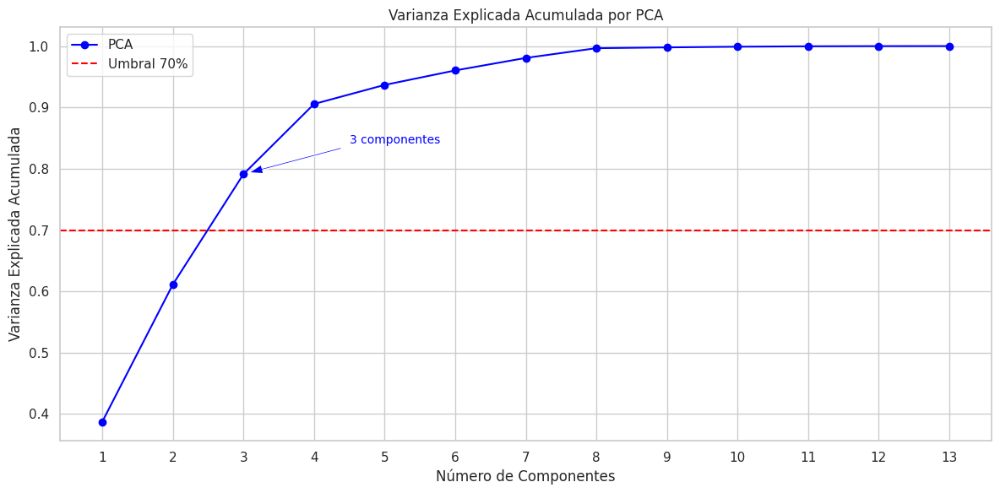

In [ ]:
# Configurar el estilo de los gráficos
sns.set(style="whitegrid")

# Determinar la varianza explicada acumulada
explained_variance_ratio_pca = np.cumsum(pca_filtered_data.explained_variance_ratio_)
n_components_pca = np.argmax(explained_variance_ratio_pca >= 0.7) + 1  # Umbral 70%

# Crear el gráfico
plt.figure(figsize=(12, 6))

# Graficar varianza explicada acumulada para PCA
plt.plot(range(1, len(explained_variance_ratio_pca) + 1), explained_variance_ratio_pca, label='PCA', color='blue', linestyle='-', marker='o')

# Agregar línea horizontal para el umbral del 70%
plt.axhline(y=0.7, color='red', linestyle='--', label='Umbral 70%')

# Ajustar manualmente las anotaciones para que apunten correctamente
plt.annotate(f'{n_components_pca} componentes',
             xy=(n_components_pca, explained_variance_ratio_pca[n_components_pca-1]),
             xytext=(n_components_pca + 1.5, explained_variance_ratio_pca[n_components_pca - 1] + 0.05),
             arrowprops=dict(facecolor='blue', shrink=0.05, width=1.5, headwidth=8),
             fontsize=10, color='blue')

# Configurar etiquetas y título
plt.xlabel('Número de Componentes')
plt.ylabel('Varianza Explicada Acumulada')
plt.title('Varianza Explicada Acumulada por PCA')

# Ajustar los ejes para que tengan valores enteros
plt.xticks(np.arange(1, len(explained_variance_ratio_pca) + 1, step=1))

# Mostrar leyenda, cuadrícula y ajustar el diseño
plt.legend()
plt.grid(True)
plt.tight_layout()

# Mostrar el gráfico
plt.savefig('vari_acumm_pca.png')
plt.show()

In [ ]:
explained_variance_ratio_pca_df = pd.DataFrame({
    'Explained Variance Ratio': explained_variance_ratio_pca
}, index=[f'Componente_{i+1}' for i in range(len(explained_variance_ratio_pca))]
)

explained_variance_ratio_pca_df

,Explained Variance Ratio
Componente_1,0.379473
Componente_2,0.612841
Componente_3,0.766566
Componente_4,0.859967
Componente_5,0.908884
Componente_6,0.938437
Componente_7,0.964953
Componente_8,0.984359
Componente_9,0.991354
Componente_10,0.998027


Estableciendo un **umbral del 70%**, las **componentes** que explican esta cantidad de **varianza explicada** son los **primeros tres componentes**, lo cual concuerda con las hipótesis planteadas en la sección anterior. Esto se debe a que se había evidenciado que los **tres primeros componentes** son los que **mayores valores propios** poseían y sus **cargas** son las que tienen **mayor influencia conjunta** con las variables del dataset original.  


### AF

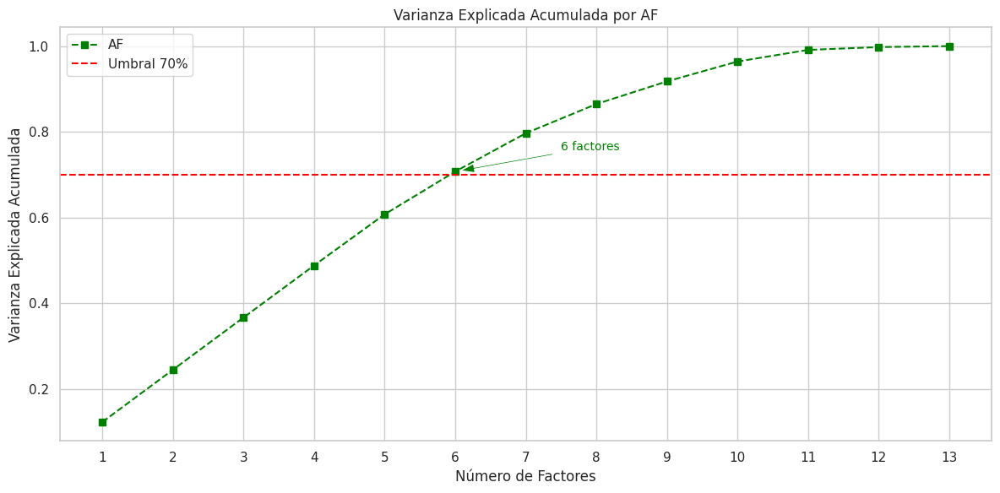

In [ ]:
# Configurar el estilo de los gráficos
sns.set(style="whitegrid")

explained_variance_ratio_fa = np.cumsum(fa_values / np.sum(fa_values))
n_factors_fa = np.argmax(explained_variance_ratio_fa >= 0.7) + 1  # Umbral 70%

# Crear el gráfico
plt.figure(figsize=(12, 6))

# Graficar varianza explicada acumulada para Análisis Factorial
plt.plot(range(1, len(explained_variance_ratio_fa) + 1), explained_variance_ratio_fa, label='AF', color='green', linestyle='--', marker='s')

# Agregar línea horizontal para el umbral del 70%
plt.axhline(y=0.7, color='red', linestyle='--', label='Umbral 70%')

# Ajustar manualmente las anotaciones para que apunten correctamente
plt.annotate(f'{n_factors_fa} factores',
             xy=(n_factors_fa, explained_variance_ratio_fa[n_factors_fa-1]),
             xytext=(n_factors_fa + 1.5, explained_variance_ratio_fa[n_factors_fa - 1] + 0.05),
             arrowprops=dict(facecolor='green', shrink=0.05, width=1.5, headwidth=8),
             fontsize=10, color='green')

# Configurar etiquetas y título
plt.xlabel('Número de Factores')
plt.ylabel('Varianza Explicada Acumulada')
plt.title('Varianza Explicada Acumulada por AF')

# Ajustar los ejes para que tengan valores enteros
plt.xticks(np.arange(1, len(explained_variance_ratio_fa) + 1, step=1))

# Mostrar leyenda, cuadrícula y ajustar el diseño
plt.legend()
plt.grid(True)
plt.tight_layout()

# Mostrar el gráfico
plt.savefig('vari_acumm_af.png')
plt.show()

In [ ]:
explained_variance_ratio_fa_df = pd.DataFrame({
    'Explained Variance Ratio': explained_variance_ratio_fa
}, index=[f'Factor_{i+1}' for i in range(len(explained_variance_ratio_fa))]
)

explained_variance_ratio_fa_df

,Explained Variance Ratio
Factor_1,0.122255
Factor_2,0.244389
Factor_3,0.366200
Factor_4,0.487749
Factor_5,0.607163
Factor_6,0.707028
Factor_7,0.796490
Factor_8,0.864672
Factor_9,0.917542
Factor_10,0.963945


Estableciendo un **umbral del 70%**, los **factores** que explican esta cantidad de **varianza explicada** son los **primeros seis factores**. Esto se debe a que se había mencionado que los **siete primeros factores** son los que **mayores valores propios** poseían y sus **cargas** eran las de **mayor influencia conjunta** con las variables del dataset original, lo cual no se aleja significativamente de lo encontrado con el umbral de la varianza explicada.  


### Combinación gráficos

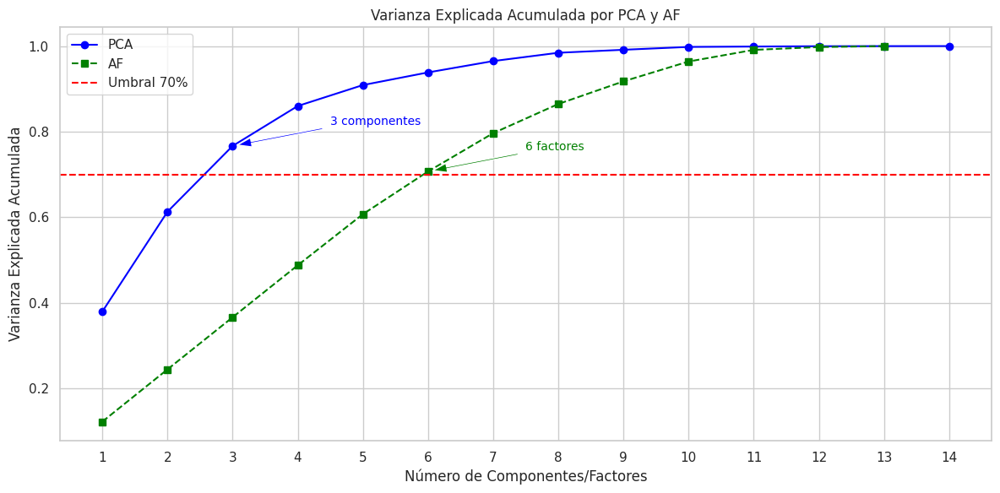

In [ ]:
# Configurar el estilo de los gráficos
sns.set(style="whitegrid")

# Determinar la varianza explicada acumulada
explained_variance_ratio_pca = np.cumsum(pca_filtered_data.explained_variance_ratio_)
n_components_pca = np.argmax(explained_variance_ratio_pca >= 0.7) + 1  # Umbral 70%

explained_variance_ratio_fa = np.cumsum(fa_values / np.sum(fa_values))
n_factors_fa = np.argmax(explained_variance_ratio_fa >= 0.7) + 1  # Umbral 70%

# Crear el gráfico
plt.figure(figsize=(12, 6))

# Graficar varianza explicada acumulada para PCA
plt.plot(range(1, len(explained_variance_ratio_pca) + 1), explained_variance_ratio_pca, label='PCA', color='blue', linestyle='-', marker='o')

# Graficar varianza explicada acumulada para Análisis Factorial
plt.plot(range(1, len(explained_variance_ratio_fa) + 1), explained_variance_ratio_fa, label='AF', color='green', linestyle='--', marker='s')

# Agregar línea horizontal para el umbral del 70%
plt.axhline(y=0.7, color='red', linestyle='--', label='Umbral 70%')

# Ajustar manualmente las anotaciones para que apunten correctamente
plt.annotate(f'{n_components_pca} componentes',
             xy=(n_components_pca, explained_variance_ratio_pca[n_components_pca-1]),
             xytext=(n_components_pca + 1.5, explained_variance_ratio_pca[n_components_pca - 1] + 0.05),
             arrowprops=dict(facecolor='blue', shrink=0.05, width=1.5, headwidth=8),
             fontsize=10, color='blue')

plt.annotate(f'{n_factors_fa} factores',
             xy=(n_factors_fa, explained_variance_ratio_fa[n_factors_fa-1]),
             xytext=(n_factors_fa + 1.5, explained_variance_ratio_fa[n_factors_fa - 1] + 0.05),
             arrowprops=dict(facecolor='green', shrink=0.05, width=1.5, headwidth=8),
             fontsize=10, color='green')

# Configurar etiquetas y título
plt.xlabel('Número de Componentes/Factores')
plt.ylabel('Varianza Explicada Acumulada')
plt.title('Varianza Explicada Acumulada por PCA y AF')

# Ajustar los ejes para que tengan valores enteros
plt.xticks(np.arange(1, len(explained_variance_ratio_pca) + 1, step=1))

# Mostrar leyenda, cuadrícula y ajustar el diseño
plt.legend()
plt.grid(True)
plt.tight_layout()

# Mostrar el gráfico
plt.savefig('vari_acumm.png')
plt.show()

## Obtener las ecuaciones de las componentes principales y factores según las variables originales

Con los **vectores propios significativos** identificados, el siguiente paso es obtener las ecuaciones de las **Componentes Principales** y los **factores**. Estos valores representan **combinaciones lineales** de las variables originales que capturan la información más relevante de los datos, respecto a las **componentes o factores**, permitiendo así el **desacople de la estructura de dependencia** de las variables originales.  

Esto sirve para darle interpretabilidad a las componentes o factores, respecto a las variables originales.


### PCA

In [ ]:
# Obtener la matriz de cargas (loadings_pca)
loadings_pca = pca_filtered_data.components_.T  # Transponemos para tener variables en columnas

# Crear un DataFrame para facilitar la manipulación
df_loadings_pca = pd.DataFrame(loadings_pca, index=normalized_df.columns, columns=[f'componente_{i+1}' for i in range(loadings_pca.shape[1])])

# Generar la expresión completa para cada componente principal
for comp in df_loadings_pca.columns:
    components_expression = []
    for var, coef in df_loadings_pca[comp].items():
        components_expression.append(f"{coef:.2f} * {var}")
    # Unir todas las contribuciones de la variable en una expresión
    expression = " + ".join(components_expression)
    print(f"{comp} = {expression}")

componente_1 = 0.23 * generation fossil gas + 0.25 * generation hydro water reservoir + 0.26 * generation solar + -0.02 * generation wind onshore + 0.26 * forecast solar day ahead + -0.02 * forecast wind onshore day ahead + 0.34 * total load forecast + 0.34 * total load actual + 0.19 * price day ahead + 0.30 * price actual + 0.33 * temp + 0.31 * temp_min + 0.33 * temp_max + -0.28 * humidity
componente_2 = -0.39 * generation fossil gas + -0.21 * generation hydro water reservoir + 0.14 * generation solar + 0.36 * generation wind onshore + 0.13 * forecast solar day ahead + 0.36 * forecast wind onshore day ahead + -0.14 * total load forecast + -0.13 * total load actual + -0.38 * price day ahead + -0.24 * price actual + 0.28 * temp + 0.28 * temp_min + 0.27 * temp_max + -0.20 * humidity
componente_3 = 0.05 * generation fossil gas + 0.24 * generation hydro water reservoir + -0.26 * generation solar + 0.49 * generation wind onshore + -0.27 * forecast solar day ahead + 0.50 * forecast wind onsh

In [ ]:
# Obtener la matriz de cargas (loadings_pca)
loadings_pca = pca_filtered_data.components_[:3, :].T  # Transponemos para tener variables en columnas

# Crear un DataFrame para facilitar la manipulación
df_loadings_pca = pd.DataFrame(loadings_pca, index=normalized_df.columns, columns=[f'componente_{i+1}' for i in range(loadings_pca.shape[1])])

# Crear una nueva matriz donde cada variable contribuye solo a la componente donde tiene el valor máximo
df_max_contrib = pd.DataFrame(0, index=normalized_df.columns, columns=[f'componente_{i+1}' for i in range(loadings_pca.shape[1])])

# Asignar cada variable a la componente principal donde su carga es máxima
for var in df_loadings_pca.index:
    max_dim = df_loadings_pca.loc[var].abs().idxmax()  # Encuentra la componente con la máxima carga en valor absoluto
    df_max_contrib.loc[var, max_dim] = df_loadings_pca.loc[var, max_dim]

# Generar la expresión para cada componente principal
for comp in df_max_contrib.columns:
    components_expression = []
    for var, coef in df_max_contrib[comp].items():
        if coef != 0:
            components_expression.append(f"{coef:.2f} * {var}")
    # Unir todas las contribuciones de la variable en una expresión
    expression = " + ".join(components_expression)
    print(f"{comp} = {expression}")

componente_1 = 0.25 * generation hydro water reservoir + 0.26 * generation solar + 0.34 * total load actual + 0.30 * price actual + 0.33 * temp + 0.31 * temp_min + 0.33 * temp_max + -0.28 * humidity
componente_2 = -0.39 * generation fossil gas + -0.38 * price day ahead
componente_3 = 0.49 * generation wind onshore + -0.27 * forecast solar day ahead + 0.50 * forecast wind onshore day ahead + 0.34 * total load forecast


De las ecuaciones anteriores se puede deducir lo siguiente:

• **Componente 1**:
- Este componente está influenciado principalmente por las fuentes de **generación hidroeléctrica de embalse** y **solar** (`generation hydro water reservoir`, `generation solar`), así como por factores climáticos (`temp`, `temp_min`, `temp_max`, `humidity`). Además, la **demanda de energía** (`total load actual`) y el **precio actual** (`price actual`) también son factores relevantes.  
- La **generación hidroeléctrica y solar** tienen pesos positivos significativos, lo que indica que este componente captura parte de la producción de energías renovables.  El impacto de la **temperatura** (máxima, mínima y promedio) también es alto, lo que sugiere que este componente refleja condiciones climáticas que afectan tanto la generación como la demanda de energía y el precio.  
- La **humedad** tiene un peso negativo, lo que sugiere que a medida que la humedad aumenta, este componente disminuye. Esto podría implicar que días más húmedos no son tan favorables para la generación de energía de algunas fuentes renovables o para la demanda de energía en general.  

• **Componente 2**:
- Este componente está influenciado por la **generación de energía a gas** (`generation fossil gas`) y el **precio del día siguiente** (`price day ahead`).  
- La **generación de energía a gas** tiene un peso negativo alto, lo que podría indicar que este componente está relacionado con factores que tienden a reducir la importancia de la generación a partir de esta fuente, probablemente en función de variaciones en el precio.  
- El **precio del día siguiente** también tiene un peso negativo, lo que puede implicar que este componente refleja una relación inversa entre el precio futuro y la generación de energía a gas, sugiriendo que un precio más alto anticipado reduce la dependencia de las fuentes fósiles.  

• **Componente 3**:
- Esta componente está mayormente influenciada por la **generación de energía eólica terrestre** (`generation wind onshore`, `forecast wind onshore day ahead`) y los **pronósticos de demanda y generación solar** para el día siguiente (`total load forecast`, `forecast solar day ahead`).  
- La **generación eólica terrestre y su pronóstico** tienen el mayor peso positivo, lo que sugiere que este componente captura principalmente las fluctuaciones en la energía eólica y su relación con los pronósticos de demanda.  
- El **pronóstico de la demanda** también tiene un peso positivo, lo que significa que este componente refleja predicciones de la demanda de energía y cómo estas están relacionadas con las expectativas de producción eólica.  
- El **pronóstico de la generación solar** tiene un peso negativo, lo que puede sugerir que cuando se espera un aumento de la generación solar, este componente disminuye, quizás indicando una competencia entre la generación solar y eólica en los días siguientes.  


### AF

In [ ]:
# Obtener la matriz de cargas (loadings_af)
loadings_af = fa_filtered_data.components_.T  # Transponemos para tener variables en columnas

# Crear un DataFrame para facilitar la manipulación
df_loadings_af = pd.DataFrame(loadings_af, index=normalized_df.columns, columns=[f'factore_{i+1}' for i in range(loadings_af.shape[1])])

# Generar la expresión completa para cada componente principal
for comp in df_loadings_af.columns:
    components_expression = []
    for var, coef in df_loadings_af[comp].items():
        components_expression.append(f"{coef:.2f} * {var}")
    # Unir todas las contribuciones de la variable en una expresión
    expression = " + ".join(components_expression)
    print(f"{comp} = {expression}")

factore_1 = 0.14 * generation fossil gas + 0.29 * generation hydro water reservoir + 0.50 * generation solar + 0.16 * generation wind onshore + 0.49 * forecast solar day ahead + 0.15 * forecast wind onshore day ahead + 0.46 * total load forecast + 0.47 * total load actual + 0.10 * price day ahead + 0.36 * price actual + 0.99 * temp + 0.96 * temp_min + 0.95 * temp_max + -0.68 * humidity
factore_2 = 0.58 * generation fossil gas + 0.57 * generation hydro water reservoir + 0.14 * generation solar + 0.13 * generation wind onshore + 0.15 * forecast solar day ahead + 0.14 * forecast wind onshore day ahead + 0.88 * total load forecast + 0.88 * total load actual + 0.44 * price day ahead + 0.52 * price actual + -0.16 * temp + -0.18 * temp_min + -0.13 * temp_max + 0.03 * humidity
factore_3 = 0.35 * generation fossil gas + 0.10 * generation hydro water reservoir + 0.54 * generation solar + -0.86 * generation wind onshore + 0.56 * forecast solar day ahead + -0.86 * forecast wind onshore day ahead +

In [ ]:
# Obtener la matriz de cargas (loadings_af)
loadings_af = fa_filtered_data.components_[:6, :].T  # Transponemos para tener variables en columnas

# Crear un DataFrame para facilitar la manipulación
df_loadings_af = pd.DataFrame(loadings_af, index=normalized_df.columns, columns=[f'factor_{i+1}' for i in range(loadings_af.shape[1])])

# Crear una nueva matriz donde cada variable contribuye solo a la componente donde tiene el valor máximo
df_max_contrib = pd.DataFrame(0, index=normalized_df.columns, columns=[f'factor_{i+1}' for i in range(loadings_af.shape[1])])

# Asignar cada variable a la componente principal donde su carga es máxima
for var in df_loadings_af.index:
    max_dim = df_loadings_af.loc[var].abs().idxmax()  # Encuentra la componente con la máxima carga en valor absoluto
    df_max_contrib.loc[var, max_dim] = df_loadings_af.loc[var, max_dim]

# Generar la expresión para cada componente principal
for comp in df_max_contrib.columns:
    components_expression = []
    for var, coef in df_max_contrib[comp].items():
        if coef != 0:
            components_expression.append(f"{coef:.2f} * {var}")
    # Unir todas las contribuciones de la variable en una expresión
    expression = " + ".join(components_expression)
    print(f"{comp} = {expression}")

factor_1 = 0.99 * temp + 0.96 * temp_min + 0.95 * temp_max + -0.68 * humidity
factor_2 = 0.58 * generation fossil gas + 0.88 * total load forecast + 0.88 * total load actual + 0.52 * price actual
factor_3 = -0.86 * generation wind onshore + -0.86 * forecast wind onshore day ahead
factor_4 = 0.65 * generation solar + 0.64 * forecast solar day ahead + -0.46 * price day ahead
factor_5 = 
factor_6 = 0.59 * generation hydro water reservoir


De las ecuaciones anteriores se puede deducir lo siguiente:

• **Factor 1**:
- Este factor está influenciado casi exclusivamente por variables relacionadas con la temperatura (`temp`, `temp_min`, `temp_max`), y en menor grado, por la **humedad** (`humidity`).
- Los pesos para las variables de temperatura son extremadamente altos (cercanos a 1), lo que sugiere que este componente captura principalmente las fluctuaciones térmicas.
- La humedad tiene un peso negativo, lo que podría indicar que cuando la temperatura es alta, la humedad tiende a ser más baja en el conjunto de datos.

• **Factor 2**:
- Este factor está influenciado por la **demanda de energía** tanto en términos reales como en su pronóstico (`total load actual`, `total load forecast`), la **generación de energía a partir de gas** (`generation fossil gas`) y el **precio de la energía** (`price actual`).
- La **demanda de energía** y su **pronóstico** tienen un peso extremadamente alto, lo que indica que este factor está principalmente relacionado con la demanda energética.
- La **generación a base de gas fósil** es un factor secundario pero importante, lo que sugiere que este factor captura el equilibrio entre la demanda y la oferta de fuentes fósiles.

• **Factor 3**:
- Este factor está influenciado por la **generación eólica terrestre** (`generation wind onshore`) y su **pronóstico** (`generation wind onshore day ahead`).
- Los pesos son iguales y negativos para ambas variables, lo que puede indicar una relación inversa entre ambas, o que cuando una de estas fuentes aumenta, este factor disminuye.

• **Factor 4**:
- Este factor está influenciado por la **generación de energía solar** (`generation solar`) y su **pronóstico** para el día siguiente (`forecast solar day ahead`).
- Tanto la **generación solar** como su **pronóstico** tienen pesos similares y altos, lo que sugiere que este factor captura las fluctuaciones en la producción de energía solar.
- El **precio de la energía al día siguiente** tiene un peso negativo, lo que podría indicar una relación inversa entre la cantidad de **energía solar generada** y los **precios de la energía para el día siguiente**.

• **Factor 5**:
- Es posible que el **factor 5** tenga pesos pequeños, pero distribuidos uniformemente entre varias variables. En lugar de tener una fuerte asociación con pocas variables, este factor parece estar difusamente relacionado con muchas variables a la vez, sin ninguna que destaque significativamente. Esto podría indicar que representa una relación compleja entre varias variables, en lugar de un patrón claro e interpretable como en los factores anteriores.

• **Factor 6**:
- Este factor está **influenciado únicamente por la generación hidroeléctrica de embalse** (`generation hydro water reservoir`).
- La generación hidroeléctrica es la única variable con un peso moderado, lo que sugiere que este componente refleja principalmente las fluctuaciones en la producción hidroeléctrica.


## Resultados Reducción de Dimensionalidad

Para comparar el **Análisis de Componentes Principales (PCA)** y el **Análisis Factorial (AF)**, se evaluaron los resultados en términos de **varianza explicada y vectores propios**.  

Ambos métodos buscan **reducir la dimensionalidad** y captar las **estructuras de dependencia de los datos**, pero con enfoques distintos:
- **El PCA** maximiza la **varianza explicada**.
- **El AF** modela las **relaciones latentes** entre las variables.

Esta comparación permitirá identificar cuál de estos métodos es **más adecuado** para este conjunto de datos.

---
**Varianza**
- **ACP**:  
  - Su objetivo es maximizar la varianza total en cada componente.
  - Los componentes principales son combinaciones lineales de las variables originales.
  - En este caso, las tres primeras componentes capturan una gran cantidad de varianza, alcanzando el 70% del umbral establecido.

- **AF**:  
  - Se enfoca en identificar factores latentes que explican las correlaciones entre las variables.
  - En este caso, se necesitaron 6 factores para explicar el 70% de la varianza.

---
**Vectores Propios**
- **ACP**:  
  - **Componente 1** tiene las cargas más altas en 8 de las 14 variables.
  - Es el componente que más varianza explica en todo el análisis y supera en capacidad explicativa a los factores del AF.
  - Este componente captura principalmente la producción de fuentes de energía renovable y su relación con las condiciones climáticas, facilitando el análisis e inferencias.
  - **Componentes 2 y 3** tienen las cargas más altas para 2 y 4 variables, respectivamente.

- **AF**:  
  - Se necesitó el doble de factores para explicar el umbral deseado.
  - No existe un único factor que pueda concentrar tantas variables como en el ACP.
  - **Factor 1** fue el que mejor agrupó variables, concentrando las variables climáticas (`temp`, `temp_min`, `temp_max`, `humidity`), sin incluir variables de generación, lo que facilita su interpretación.
  - **Factor 5** representa una gran cantidad de varianza explicada, pero no tiene una carga significativa en ninguna variable relevante, lo que lo desacopla del resto de los factores, reduciendo su utilidad interpretativa.

---



Con base en los análisis realizados, **el Análisis de Componentes Principales (PCA) es el método más adecuado** para este conjunto de datos, ya que presentó mejores resultados en:

1. **Varianza explicada**:  
   - Solo necesitó **tres componentes** para explicar el mas del 70% de la varianza.
   - AF requirió **seis factores** para alcanzar un nivel similar.

2. **Vectores propios e interpretabilidad**:  
   - **Los vectores propios en el PCA** permitieron identificar relaciones claras entre las componentes y las variables.
   - Variables como **precio de energía** (`price actual`), **demanda total** (`total load actual`), **generación solar** (`generation solar`), **generación hidroeléctrica** (`generation hydro water reservoir`) y **variables climáticas** (`temp`, `temp_min`, `temp_max`, `humidity`) se asocian naturalmente con el contexto de generación de energía.

Por estas razones, el PCA se considera el mejor método para este análisis, al proporcionar una mejor reducción de dimensionalidad, mayor capacidad explicativa con menos componentes y mejor interpretación de los resultados.

# Referencias

[1] "Hourly Energy Demand Generation and Weather." [Online]. Available: [https://www.kaggle.com/datasets/nicholasjhana/energy-consumption-generation-prices-and-weather](https://www.kaggle.com/datasets/nicholasjhana/energy-consumption-generation-prices-and-weather).  

[2] *Chapter 5: Atmospheric Stability – Atmospheric Processes and Phenomena.* [Online]. Available: [https://pressbooks-dev.oer.hawaii.edu/atmo/chapter/chapter-5-atmospheric-stability/](https://pressbooks-dev.oer.hawaii.edu/atmo/chapter/chapter-5-atmospheric-stability/).  

[3] S. S. Shapiro and M. B. Wilk, "An Analysis of Variance Test for Normality (Complete Samples)," *Biometrika*, vol. 52, no. 3/4, pp. 591–611, 1965. [Online]. Available: [https://doi.org/10.2307/2333709](https://doi.org/10.2307/2333709).  

[4] "Spearman Correlation - an Overview | ScienceDirect Topics." [Online]. Available: [https://www.sciencedirect.com/topics/mathematics/spearman-correlation](https://www.sciencedirect.com/topics/mathematics/spearman-correlation).  

[5] N. Henze and B. Zirkler, "A class of invariant consistent tests for multivariate normality," *Communications in Statistics-Theory and Methods*, vol. 19, no. 10, pp. 3595–3617, 1990.  

[6] M. S. Bartlett, "Properties of Sufficiency and Statistical Tests," *Proc. Roy. Soc. London, Ser. A, Math. Phys. Sci.*, vol. 160, no. 901, pp. 268–282, 1937. [Online]. Available: [https://www.jstor.org/stable/96803](https://www.jstor.org/stable/96803).  

[7] H. F. Kaiser, "A Second Generation Little Jiffy," *Psychometrika*, vol. 35, no. 4, pp. 401–415, Dec. 1970. [Online]. Available: [https://doi.org/10.1007/BF02291817](https://doi.org/10.1007/BF02291817).  
